## Advanced Lane Finding Project

The goals / steps of this project are the following:

* Compute the camera calibration matrix and distortion coefficients given a set of chessboard images.
* Apply a distortion correction to raw images.
* Use color transforms, gradients, etc., to create a thresholded binary image.
* Apply a perspective transform to rectify binary image ("birds-eye view").
* Detect lane pixels and fit to find the lane boundary.
* Determine the curvature of the lane and vehicle position with respect to center.
* Warp the detected lane boundaries back onto the original image.
* Output visual display of the lane boundaries and numerical estimation of lane curvature and vehicle position.

---
## Steps we’ve covered so far:

* Camera calibration
* Distortion correction
* Color/gradient threshold
* Perspective transform

After doing these steps, you’ll be given two additional steps for the project:

* Detect lane lines
* Determine the lane curvature


## First, I'll compute the camera calibration using chessboard images

objp.shape= (54, 3)

Start to do_calibration:
ret= 1.0298151483875222 , mtx.shape= (3, 3)
gmtx= [[  1.15777942e+03   0.00000000e+00   6.67111050e+02]
 [  0.00000000e+00   1.15282305e+03   3.86129068e+02]
 [  0.00000000e+00   0.00000000e+00   1.00000000e+00]]
gdist= [[-0.24688833 -0.02372817 -0.00109843  0.00035105 -0.00259134]]


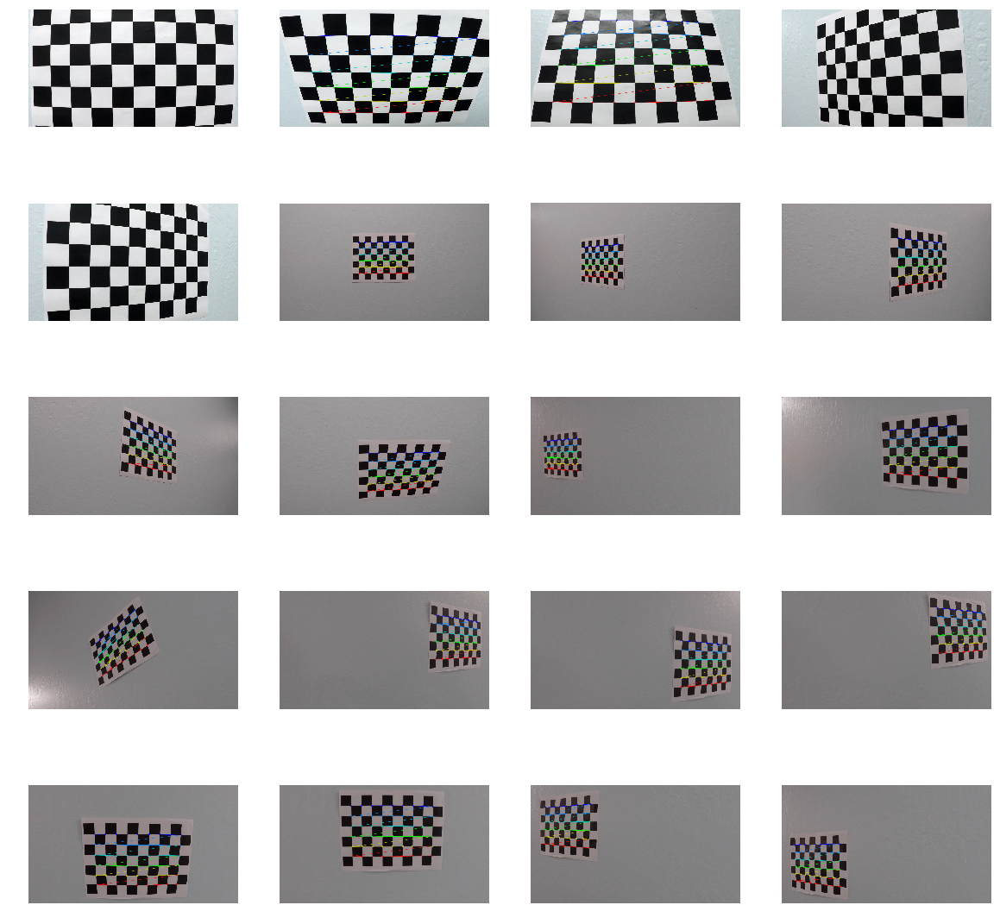

In [1]:
import numpy as np
import cv2
import glob
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
%matplotlib qt
%matplotlib inline


FONTSIZE = 15

# prepare object points
nx = 9 #TODO: enter the number of inside corners in x
ny = 6 #TODO: enter the number of inside corners in y

debug_show = True

############################### 1.Camera calibration #########################

# prepare object points, like (0,0,0), (1,0,0), (2,0,0) ....,(6,5,0)
objp = np.zeros((ny*nx, 3), np.float32)
#objp.shape= (54, 3)
objp[:,:2] = np.mgrid[0:9,0:6].T.reshape(-1,2)
print ('objp.shape=', objp.shape)
#print ('objp=\n', objp)

# Arrays to store object points and image points from all the images.
objpoints = [] # 3d points in real world space
imgpoints = [] # 2d points in image plane.
img_size = []

gmtx = []
gdist = [] 
grvecs = []
gtvecs = []


def do_calibration():
    
    # Make a list of calibration images
    #images = glob.glob('camera_cal/calibration*.jpg')
    
    plt.figure(figsize = (20,20))
    # Step through the list and search for chessboard corners
    #for fname in images:
    for idx in range(20):
        fname = 'camera_cal/calibration'+ str(idx+1) + '.jpg'
        #print ('\nfile ', idx, ' =', fname)
        img = cv2.imread(fname)
        img_size = img.shape[1::-1] 
        
        gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
        #print ('img_size=', img_size)
        #plt.figure()
        #plt.imshow(gray,cmap='gray')

        # Find the chessboard corners
        ret, corners = cv2.findChessboardCorners(gray, (nx, ny),None)
        #print ('findChessboardCorners ret=', ret)

        plt.subplot(5,4,idx+1)
        # If found, add object points, image points
        if ret == True:
            #print ('type(corners)=', type(corners), ', corners.shape=', corners.shape)
            objpoints.append(objp)
            imgpoints.append(corners)

            # Draw and display the corners
            img = cv2.drawChessboardCorners(img, (nx, ny), corners, ret)
            #cv2.imshow('img',img)
            #cv2.waitKey(500)
        #break
        plt.imshow(img)
        plt.axis('off')

    #cv2.destroyAllWindows()

    ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, img_size,None,None)

    return ret, mtx, dist, rvecs, tvecs

############# Do calibration ################
ret, gmtx, gdist, grvecs, gtvecs = do_calibration()

if (debug_show):
    print ('\nStart to do_calibration:')
    print ('ret=', ret, ', mtx.shape=', gmtx.shape)
    print ('gmtx=', gmtx)
    print ('gdist=', gdist)
    #print ('grvecs=', grvecs)
    #print ('gtvecs=', gtvecs)



## Second, I'll undistort the chessboard images

gmtx= [[  1.15777942e+03   0.00000000e+00   6.67111050e+02]
 [  0.00000000e+00   1.15282305e+03   3.86129068e+02]
 [  0.00000000e+00   0.00000000e+00   1.00000000e+00]]
gdist= [[-0.24688833 -0.02372817 -0.00109843  0.00035105 -0.00259134]]
gmtx= [[  1.15777942e+03   0.00000000e+00   6.67111050e+02]
 [  0.00000000e+00   1.15282305e+03   3.86129068e+02]
 [  0.00000000e+00   0.00000000e+00   1.00000000e+00]]
gdist= [[-0.24688833 -0.02372817 -0.00109843  0.00035105 -0.00259134]]
gmtx= [[  1.15777942e+03   0.00000000e+00   6.67111050e+02]
 [  0.00000000e+00   1.15282305e+03   3.86129068e+02]
 [  0.00000000e+00   0.00000000e+00   1.00000000e+00]]
gdist= [[-0.24688833 -0.02372817 -0.00109843  0.00035105 -0.00259134]]
gmtx= [[  1.15777942e+03   0.00000000e+00   6.67111050e+02]
 [  0.00000000e+00   1.15282305e+03   3.86129068e+02]
 [  0.00000000e+00   0.00000000e+00   1.00000000e+00]]
gdist= [[-0.24688833 -0.02372817 -0.00109843  0.00035105 -0.00259134]]
gmtx= [[  1.15777942e+03   0.00000000e+0

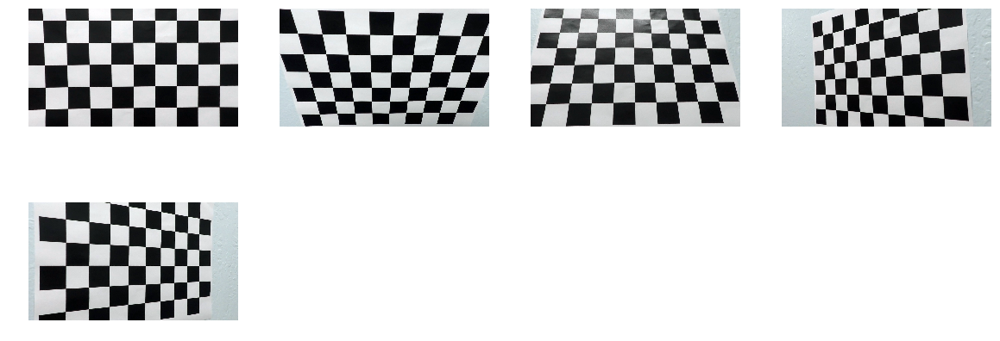

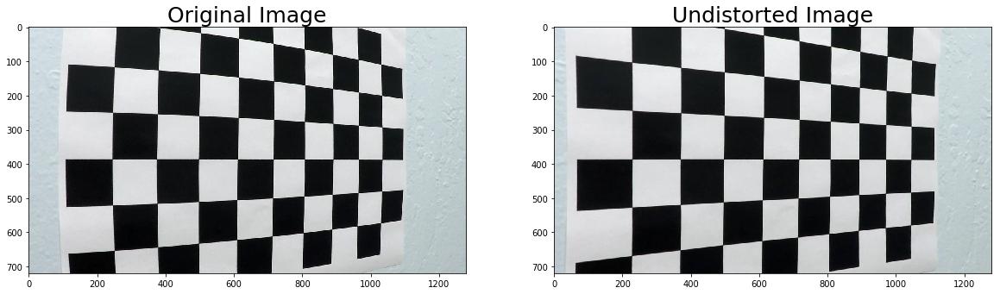

In [2]:

############################### 2. undistort image #########################
"""
fname = 'camera_cal/calibration5.jpg'
#fname = 'camera_cal/calibration17.jpg'
img = cv2.imread(fname)
print ('cv2 imread.shape=', img.shape)
"""

def do_undistort(img):
    global gmtx, gdist
    dst = cv2.undistort(img, gmtx, gdist, None, gmtx)
    
    if (debug_show == True):
        print ('gmtx=', gmtx)
        print ('gdist=', gdist)
    
    return dst


############ Test undistort image #############
plt.figure(figsize = (20,20))
# Step through the list and search for chessboard corners
#for fname in images:
for idx in range(5):
    fname = 'camera_cal/calibration'+ str(idx+1) + '.jpg'
    #print ('\nfile ', idx, ' =', fname)
    img = cv2.imread(fname)
    img_size = img.shape[1::-1] 
    
    dst = do_undistort(img)
    
    plt.subplot(5,4,idx+1)
    plt.imshow(dst)
    plt.axis('off')
    
    
######### Test undistort image #######################
fname = 'camera_cal/calibration5.jpg'
#fname = 'camera_cal/calibration7.jpg'
#print ('\nfile ', idx, ' =', fname)
img = cv2.imread(fname)
img_size = img.shape[1::-1] 

dst = do_undistort(img)


plt.figure(figsize=(20,15))
plt.subplot(1,2,1).set_title('Original Image', fontsize=25)
plt.imshow(img,cmap ='gray')
plt.subplot(1,2,2).set_title('Undistorted Image', fontsize=25)
plt.imshow(dst,cmap ='gray')


In [3]:

############################### 3.Color/gradient threshold #########################


# Define a function that applies Sobel x or y, 
# then takes an absolute value and applies a threshold.
# Note: calling your function with orient='x', thresh_min=5, thresh_max=100
# should produce output like the example image shown above this quiz.
def abs_sobel_thresh(img, orient='X', sobel_kernel=3, thresh=(0, 255)):  
    print ('\n############# Orient=', orient, ' ,thresh=', thresh, ' #############')  
    # Apply the following steps to img
    # 1) Convert to grayscale
    gray_img = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    print ('gray_img.shape=', gray_img.shape )
    #print ('gray_img[:5, :10]=', gray_img[:5, :10], '\n')
    
    # 2) Take the derivative in x or y given orient = 'x' or 'y'
    if (orient == 'X'):
        sobel = cv2.Sobel(gray_img, cv2.CV_64F, 1, 0, sobel_kernel)
    else:
        sobel = cv2.Sobel(gray_img, cv2.CV_64F, 0, 1, sobel_kernel)
    print ('orient=', orient, ' ,sobel=', sobel.shape )
    #sobelx= (720, 1280) sobely= (720, 1280)
    #print ('sobel[:5, :10]=', sobel[:5, :10])
    
    # 3) Take the absolute value of the derivative or gradient
    abs_sobel = np.absolute(sobel)
    print ('\nabs_sobel=', abs_sobel.shape )
    print ('np.max(abs_sobel)=', np.max(abs_sobel))
    #abs_sobelx= (720, 1280) abs_sobely= (720, 1280)
    #print ('abs_sobel[:5, :10]=', abs_sobel[:5, :10])
    
    # 4) Scale to 8-bit (0 - 255) then convert to type = np.uint8
    scaled_sobel = np.uint8(255*abs_sobel/np.max(abs_sobel))
    print ('\nscaled_sobel=', scaled_sobel.shape )
    #scaled_sobel= (720, 1280)
    #print ('scaled_sobel[:5, :10]=', scaled_sobel[:5, :10])
    
    # 5) Create a mask of 1's where the scaled gradient magnitude 
            # is > thresh_min and < thresh_max
    print ('\nthresh[0,1]=', thresh)
    binary_output = np.zeros_like(scaled_sobel)
    binary_output[(scaled_sobel >= thresh[0]) & (scaled_sobel <= thresh[1])] = 1
    #print ('binary_output[:5, :10] .2=', binary_output[:5, :10])
    
    if (debug_show == True):
        plt.figure(figsize = (15,10))
        plt.subplot(1,2,1).set_title('Original image', fontsize=FONTSIZE)
        plt.imshow(img, cmap='gray')
        plt.subplot(1,2,2).set_title('Sobel-' + orient + ' image', fontsize=FONTSIZE)
        plt.imshow(binary_output, cmap='gray')
        
    # 6) Return this mask as your binary_output image
    #binary_output = np.copy(img) # Remove this line
    return binary_output

#Magnitude threshold
def sobel_x(img, sobel_kernel=3,min_thres = 20, max_thres =100):
    # Apply the following steps to img
    # 1) Convert to grayscale
    imghsl = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
    # 2) Take the gradient in x and y separately
    #Channels L and S from HLS
    sobelx1 = cv2.Sobel(imghsl[:,:,1], cv2.CV_64F, 1,0, ksize=sobel_kernel)
    sobelx2 = cv2.Sobel(imghsl[:,:,2], cv2.CV_64F, 1,0, ksize=sobel_kernel)
        
    # 4) Scale to 8-bit (0 - 255) and convert to type = np.uint8
    scaled_sobelx1 = np.uint8(255*sobelx1/ np.max(sobelx1))
    scaled_sobelx2 = np.uint8(255*sobelx2/ np.max(sobelx2))

    # 5) Create a binary mask where mag thresholds are met
    binary_outputx1 = np.zeros_like(scaled_sobelx1)
    binary_outputx1[(scaled_sobelx1 >= min_thres) & (scaled_sobelx1 <= max_thres)] = 1

    binary_outputx2 = np.zeros_like(scaled_sobelx2)
    binary_outputx2[(scaled_sobelx2 >= min_thres) & (scaled_sobelx2 <= max_thres)] = 1

    binary_output = np.zeros_like(scaled_sobelx1)
    binary_output[(binary_outputx1 ==1) | (binary_outputx2 ==1)]=1
    # 6) Return this mask as your binary_output image
    return binary_output
   
    
# Define a function that applies Sobel x and y, 
# then computes the magnitude of the gradient
# and applies a threshold
def mag_thresh(img, sobel_kernel=3, mag_thresh=(0, 255)):
    print ('\n############# ksize=', sobel_kernel, ' ,mag_thresh=', mag_thresh, ' #############')
    # Apply the following steps to img
    # 1) Convert to grayscale
    gray_img = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    #print ('gray_img.shape=', gray_img.shape )
    #print ('gray_img[:5, :10]=', gray_img[:5, :10])
    
    # 2) Take the gradient in x and y separately
    sobelx = cv2.Sobel(gray_img, cv2.CV_64F, 1, 0, sobel_kernel)
    sobely = cv2.Sobel(gray_img, cv2.CV_64F, 0, 1, sobel_kernel)
    print ('sobelx=', sobelx.shape, ' ,sobely=', sobely.shape )
    #sobelx= (720, 1280) sobely= (720, 1280)
    #print ('sobelx[:5, :10]=', sobelx[:5, :10])
    #print ('sobely[:5, :10]=', sobely[:5, :10])
    
    # 3) Calculate the magnitude 
    gradmag = np.sqrt(sobelx**2 + sobely**2)
    print ('\ngradmag=', gradmag.shape)
    #print ('gradmag[:5, :10]=', gradmag[:5, :10])
    
    # 4) Scale to 8-bit (0 - 255) and convert to type = np.uint8
    scale_factor = np.max(gradmag)/255 
    gradmag = (gradmag/scale_factor).astype(np.uint8) 
    print ('gradmag[130:135, :20]=', gradmag[130:135, :20])
    
    # 5) Create a binary mask where mag thresholds are met
    binary_output = np.zeros_like(gradmag)
    binary_output[(gradmag >= mag_thresh[0]) & (gradmag <= mag_thresh[1])] = 1
    print ('\nbinary_output[130:135, :20]=', binary_output[130:135, :20])
        
    if (debug_show == True):
        plt.figure(figsize = (15,10))
        plt.subplot(1,2,1).set_title('Original image', fontsize=FONTSIZE)
        plt.imshow(img, cmap='gray')
        plt.subplot(1,2,2).set_title('Magnitude=sqrt(x**2 + y**2) ksize='+str(sobel_kernel)+' image', fontsize=FONTSIZE)
        plt.imshow(binary_output, cmap='gray')
            
    # 6) Return this mask as your binary_output image
    #binary_output = np.copy(img) # Remove this line
    return binary_output
 
    
# Define a function that applies Sobel x and y, 
# then computes the direction of the gradient
# and applies a threshold.
def dir_threshold(img, sobel_kernel=3, thresh=(0, np.pi/2)):
    
    # Apply the following steps to img
    # 1) Convert to grayscale
    gray_img = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    #print ('gray_img.shape=', gray_img.shape )
    #print ('gray_img[:5, :10]=', gray_img[:5, :10])
    #plt.figure()
    #plt.imshow(gray_img,cmap='gray')
    
    # 2) Take the gradient in x and y separately
    sobelx = cv2.Sobel(gray_img, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    sobely = cv2.Sobel(gray_img, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    print ('sobelx=', sobelx.shape, ' ,sobely=', sobely.shape )
    #sobelx= (720, 1280) sobely= (720, 1280)
    
    # 3) Take the absolute value of the x and y gradients
    abs_sobelx = np.absolute(sobelx)    
    abs_sobely = np.absolute(sobely)
    print ('abs_sobelx=', abs_sobelx.shape )
    print ('abs_sobely=', abs_sobely.shape )
    
    # 4) Use np.arctan2(abs_sobely, abs_sobelx) to calculate the direction of the gradient 
    gradient = np.arctan2(abs_sobely, abs_sobelx)
    print ('\ngradient[130:135, :20]=', gradient[130:135, :20])
    
    # 5) Create a binary mask where direction thresholds are met
    binary_output = np.zeros_like(gradient)
    binary_output[(gradient >= thresh[0]) & (gradient <= thresh[1])] = 1
    print ('\nbinary_output[130:135, :20]=', binary_output[130:135, :20])
    
    if (debug_show == True):
        plt.figure(figsize = (15,10))
        plt.subplot(1,2,1).set_title('Original image', fontsize=FONTSIZE)
        plt.imshow(img, cmap='gray')
        plt.subplot(1,2,2).set_title('Direction=arctan2(abs_sobely, abs_sobelx) ksize='+str(sobel_kernel)+' image', fontsize=FONTSIZE)
        plt.imshow(binary_output, cmap='gray')
                
    # 6) Return this mask as your binary_output image
    #binary_output = np.copy(img) # Remove this line
    return binary_output
    
    #def hls_color_thresh(img, threshH,threshL, threshS):
def hls_color_thresh(img, threshLow, threshHigh):
    # 1) Convert to HLS color space
    imgHLS = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
    #imgHLS = cv2.cvtColor(img, cv2.COLOR_RGB2HSV)
    #Hue (0,180) Light (0,255), satur (0,255)

   
    # 3) Return a binary image of threshold result
    binary_output = np.zeros((img.shape[0], img.shape[1]))
    #binary_output[(imgHLS[:,:,0] >= threshH[0]) & (imgHLS[:,:,0] <= threshH[1]) & (imgHLS[:,:,1] >= threshL[0]) & (imgHLS[:,:,1] <= threshL[1])  | ((imgHLS[:,:,2] >= threshS[0]) & (imgHLS[:,:,2] <= threshS[1]))] = 1
    binary_output[(imgHLS[:,:,0] >= threshLow[0]) 
                  & (imgHLS[:,:,0] <= threshHigh[0]) 
                  & (imgHLS[:,:,1] >= threshLow[1])  
                  & (imgHLS[:,:,1] <= threshHigh[1]) 
                  & (imgHLS[:,:,2] >= threshLow[2]) 
                  & (imgHLS[:,:,2] <= threshHigh[2])] = 1
    #print ('hls_color_thresh binary_output.shape=', binary_output.shape)
                 
    return binary_output, imgHLS

#def hls_color_thresh(img, threshH,threshL, threshS):
def hsv_color_thresh(img, threshLow, threshHigh):
    # 1) Convert to HLS color space
    #imgHLS = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
    imgHSV = cv2.cvtColor(img, cv2.COLOR_RGB2HSV)
    #Hue (0,180) Light (0,255), satur (0,255)
   
    # 3) Return a binary image of threshold result
    binary_output = np.zeros((img.shape[0], img.shape[1]))
    binary_output[(imgHSV[:,:,0] >= threshLow[0]) 
                  & (imgHSV[:,:,0] <= threshHigh[0]) 
                  & (imgHSV[:,:,1] >= threshLow[1])  
                  & (imgHSV[:,:,1] <= threshHigh[1]) 
                  & (imgHSV[:,:,2] >= threshLow[2]) 
                  & (imgHSV[:,:,2] <= threshHigh[2])] = 1
    #print ('hsv_color_threshbinary_output.shape=', binary_output.shape)
                 
    return binary_output, imgHSV


Examples of color thresholds

############# Orient= X  ,thresh= (20, 100)  #############
gray_img.shape= (720, 1280)
orient= X  ,sobel= (720, 1280)

abs_sobel= (720, 1280)
np.max(abs_sobel)= 865.0

scaled_sobel= (720, 1280)

thresh[0,1]= (20, 100)

############# Orient= Y  ,thresh= (30, 80)  #############
gray_img.shape= (720, 1280)
orient= Y  ,sobel= (720, 1280)

abs_sobel= (720, 1280)
np.max(abs_sobel)= 881.0

scaled_sobel= (720, 1280)

thresh[0,1]= (30, 80)

############# ksize= 5  ,mag_thresh= (30, 80)  #############
sobelx= (720, 1280)  ,sobely= (720, 1280)

gradmag= (720, 1280)
gradmag[130:135, :20]= [[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
 [0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
 [0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
 [0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
 [0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]]

binary_output[130:135, :20]= [[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
 [0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
 [0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
 [0 0 0 0 0

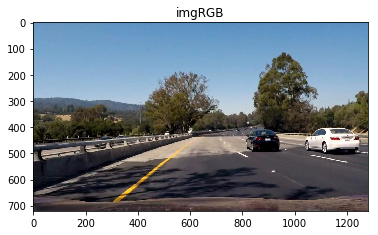

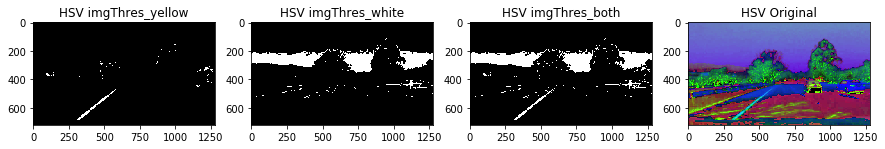

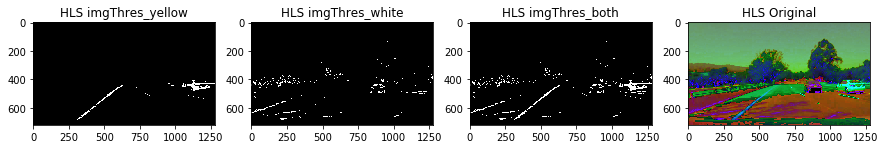

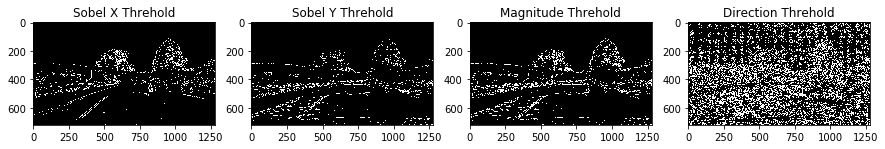

In [4]:
#Examples of color thresholds

#img = cv2.imread("test_images/test1.jpg")
#img = cv2.imread("test_images/test6.jpg")
#imgRGB = mpimg.imread("test_images/straight_lines2.jpg")
#imgRGB = mpimg.imread("test_images/project_video_39_clip7.jpg")
#imgRGB = mpimg.imread("test_images/project_video_39_clip8.jpg")
imgRGB = mpimg.imread("test_images/project_video_39_clip9.jpg")


plt.figure()
plt.title('imgRGB')
plt.imshow(imgRGB)


#imgHLS = cv2.cvtColor(imgRGB, cv2.COLOR_RGB2HLS)
#print(np.max(imgHLS[:,:,0]))

print("Examples of color thresholds")

yellow_low = np.array([0,100,100])
yellow_high = np.array([50,255,255])
white_low = np.array([18,0,180])
white_high = np.array([255,80,255])

################# HSV ####################
imgThres_yellow, org_img = hsv_color_thresh(imgRGB,yellow_low,yellow_high)
imgThres_white, org_img  = hsv_color_thresh(imgRGB,white_low,white_high)
imgThres_both =np.zeros_like(imgThres_yellow)
imgThres_both[(imgThres_yellow==1) | (imgThres_white==1)] =1

plt.figure(figsize=(15,8))
plt.subplot(1,4,1).set_title('HSV imgThres_yellow')
plt.imshow(imgThres_yellow,cmap ='gray')

plt.subplot(1,4,2).set_title('HSV imgThres_white')
plt.imshow(imgThres_white,cmap ='gray')

plt.subplot(1,4,3).set_title('HSV imgThres_both')
plt.imshow(imgThres_both,cmap ='gray')

plt.subplot(1,4,4).set_title('HSV Original')
plt.imshow(org_img)#,cmap ='gray')

################# HLS ####################

yellow_low = np.array([0,100,100])
yellow_high = np.array([50,255,255])
white_low = np.array([18,0,180])
white_high = np.array([255,80,255])

imgThres_yellow2, org_img  = hls_color_thresh(imgRGB,yellow_low,yellow_high)
imgThres_white2, org_img  = hls_color_thresh(imgRGB,white_low,white_high)
imgThres_both2 =np.zeros_like(imgThres_yellow2)
imgThres_both2[(imgThres_yellow2==1) | (imgThres_white2==1)] =1

plt.figure(figsize=(15,8))
plt.subplot(1,4,1).set_title('HLS imgThres_yellow')
plt.imshow(imgThres_yellow2,cmap ='gray')

plt.subplot(1,4,2).set_title('HLS imgThres_white')
plt.imshow(imgThres_white2,cmap ='gray')

plt.subplot(1,4,3).set_title('HLS imgThres_both')
plt.imshow(imgThres_both2,cmap ='gray')

plt.subplot(1,4,4).set_title('HLS Original')
plt.imshow(org_img)#,cmap ='gray')
           

#############  Gradient Theshold ############
debug_show = False
gradx = abs_sobel_thresh(imgRGB, orient='X', sobel_kernel=5, thresh=(20, 100))
grady = abs_sobel_thresh(imgRGB, orient='Y', sobel_kernel=5, thresh=(30, 80))
mag_binary = mag_thresh(imgRGB, sobel_kernel=5, mag_thresh=(30, 80))
dir_binary = dir_threshold(imgRGB, sobel_kernel=5, thresh=(0.7, 1.3))
    
plt.figure(figsize=(15,8))
plt.subplot(1,4,1).set_title('Sobel X Threhold')
plt.imshow(gradx,cmap ='gray')

plt.subplot(1,4,2).set_title('Sobel Y Threhold')
plt.imshow(grady,cmap ='gray')

plt.subplot(1,4,3).set_title('Magnitude Threhold')
plt.imshow(mag_binary,cmap ='gray')

plt.subplot(1,4,4).set_title('Direction Threhold')
plt.imshow(dir_binary, cmap ='gray')
debug_show = True

## From above test result, it seems HLS color space is better than HSV color space, HLS color space can track the lane lines more accurately without introduced the bright blue sky image.
### So we'll use HLS color space in the later steps.

image_orig.shape= (720, 1280, 3)
gmtx= [[  1.15777942e+03   0.00000000e+00   6.67111050e+02]
 [  0.00000000e+00   1.15282305e+03   3.86129068e+02]
 [  0.00000000e+00   0.00000000e+00   1.00000000e+00]]
gdist= [[-0.24688833 -0.02372817 -0.00109843  0.00035105 -0.00259134]]
luv_img.shape= (720, 1280, 3)
lab_img.shape= (720, 1280, 3)


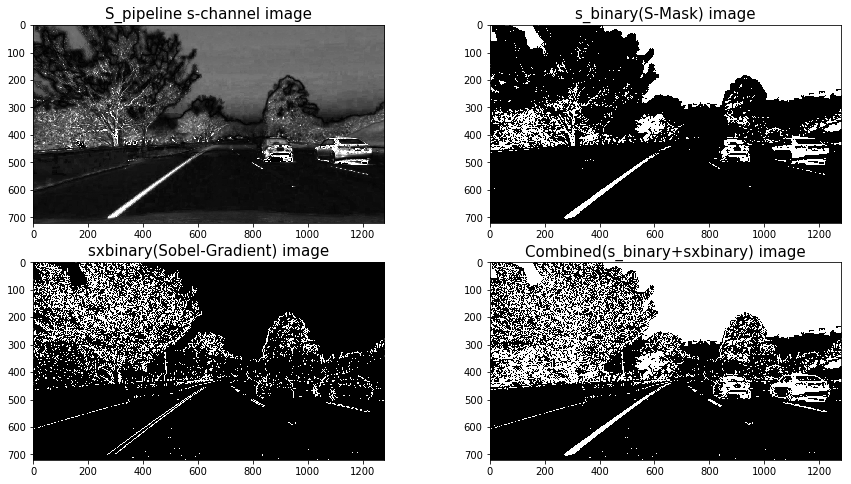

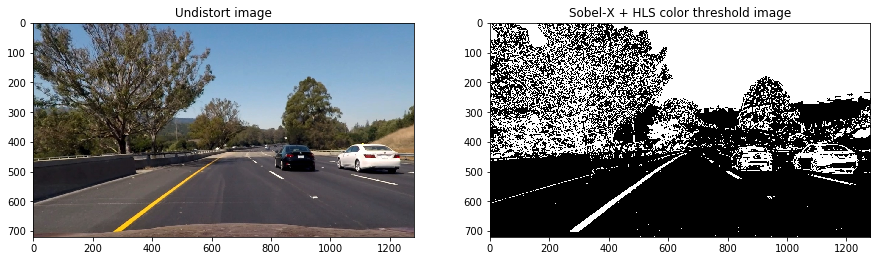

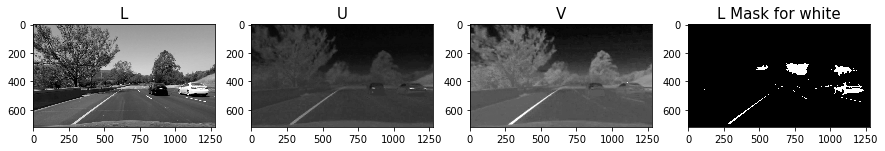

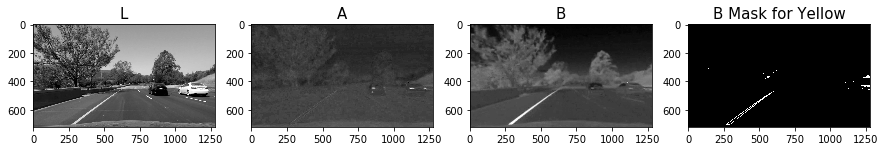

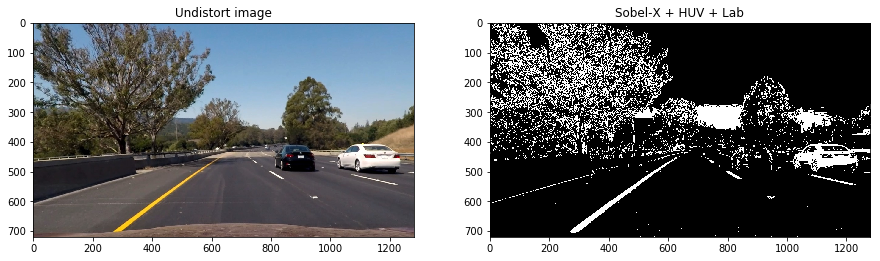

In [5]:

def S_pipeline(img, s_thresh=(170, 255), sx_thresh=(20, 100)):
    # Convert to HLS color space and separate the S channel
    # Note: img is the undistorted image
    
    ################## HLS - S channel ###########
    hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
    s_channel = hls[:,:,2]

    # Threshold color channel(Sat)
    #print ('\ns_thresh=', s_thresh)
    s_binary = np.zeros_like(s_channel)
    s_binary[(s_channel >= s_thresh[0]) & (s_channel <= s_thresh[1])] = 1
    #print ('s_binary.shape=', s_binary.shape)
    
    ################## Sobel X Channel ##########
    # Grayscale image
    # NOTE: we already saw that standard grayscaling lost color information for the lane lines
    # Explore gradients in other colors spaces / color channels to see what might work better
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)

    # Sobel x
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0) # Take the derivative in x
    abs_sobelx = np.absolute(sobelx) # Absolute x derivative to accentuate lines away from horizontal
    #print ('abs_sobelx.shape=', abs_sobelx.shape, ', abs_sobelx[:5, :10]=', abs_sobelx[:5, :10])
    
    scaled_sobel = np.uint8(255*abs_sobelx/np.max(abs_sobelx))
    #print ('np.max(abs_sobelx)=', np.max(abs_sobelx))

    # Threshold x gradient
    #print ('\nsx_thresh=', sx_thresh)
    sxbinary = np.zeros_like(scaled_sobel)
    sxbinary[(scaled_sobel >= sx_thresh[0]) & (scaled_sobel <= sx_thresh[1])] = 1
    #print ('sxbinary.shape=', sxbinary.shape)


    ################## Combined Color image ##########
    # Stack each channel to view their individual contributions in green and blue respectively
    # This returns a stack of the two binary images, whose components you can see as different colors
    #color_binary = np.dstack(( np.zeros_like(sxbinary), sxbinary, s_binary)) * 255
    #color_binary = np.dstack(( np.zeros_like(sxbinary), sxbinary, s_binary)) * 255
    color_binary = np.dstack((s_binary, np.zeros_like(sxbinary), sxbinary)) * 255  # RGB: R=s_binary, G=zeors, B=sxbinary

    # Combine the two binary thresholds
    combined_binary = np.zeros_like(sxbinary)
    combined_binary[(s_binary == 1) | (sxbinary == 1)] = 1
    #print ('combined_binary.shape=', combined_binary.shape)
    
    #out_img = np.dstack((combined_binary, combined_binary, combined_binary))*255
    #cv2.imwrite('test_images/straight_lines1_combined.jpg', out_img)
    
    if (debug_show == True):
        plt.figure(figsize = (15,8))
        plt.subplot(2,2,1).set_title('S_pipeline s-channel image', fontsize=FONTSIZE)
        plt.imshow(s_channel, cmap='gray')
        plt.subplot(2,2,2).set_title('s_binary(S-Mask) image', fontsize=FONTSIZE)
        plt.imshow(s_binary, cmap='gray')
        plt.subplot(2,2,3).set_title('sxbinary(Sobel-Gradient) image', fontsize=FONTSIZE)
        plt.imshow(sxbinary, cmap='gray')
        plt.subplot(2,2,4).set_title('Combined(s_binary+sxbinary) image', fontsize=FONTSIZE)
        plt.imshow(combined_binary, cmap='gray')
    
    return combined_binary


        
def L_pipeline(img, w_thresh=(225, 255), y_thresh=(155, 200), sx_thresh=(50, 100)):
    # Convert to HLS color space and separate the S channel
    # Note: img is the undistorted image
        
    ###############  # LUV, L for white lane lines ############
    luv_img = cv2.cvtColor(img, cv2.COLOR_RGB2LUV)
    L0 = luv_img[:,:,0]
    l_binary = np.zeros_like(L0)
    l_binary[(L0 >= w_thresh[0]) & (L0 <= w_thresh[1])] = 1
    
    if (debug_show == True): 
    #if (False):
        print ('luv_img.shape=', luv_img.shape)
        U0 = luv_img[:,:,1]
        V0 = luv_img[:,:,2]     
        plt.figure(figsize = (15,8))
        plt.subplot(1,4,1).set_title('L', fontsize=FONTSIZE)
        plt.imshow(L0, cmap='gray')
        plt.subplot(1,4,2).set_title('U', fontsize=FONTSIZE)
        plt.imshow(U0, cmap='gray')
        plt.subplot(1,4,3).set_title('V', fontsize=FONTSIZE)
        plt.imshow(V0, cmap='gray')
        plt.subplot(1,4,4).set_title('L Mask for white', fontsize=FONTSIZE)
        plt.imshow(l_binary, cmap='gray')
    
    ##################  LAB, B for Yellow lane lines ###########
    lab_img = cv2.cvtColor(img, cv2.COLOR_RGB2LAB)
    B0 = lab_img[:,:,2]
    # Threshold color channel(Sat)
    b_binary = np.zeros_like(B0)
    b_binary[(B0 >= y_thresh[0]) & (B0 <= y_thresh[1])] = 1

    if (debug_show == True):
    #if (False):
        print ('lab_img.shape=', lab_img.shape)
        L0 = lab_img[:,:,0]
        A0 = lab_img[:,:,1]
        plt.figure(figsize = (15,8))
        plt.subplot(1,4,1).set_title('L', fontsize=FONTSIZE)
        plt.imshow(L0, cmap='gray')
        plt.subplot(1,4,2).set_title('A', fontsize=FONTSIZE)
        plt.imshow(A0, cmap='gray')
        plt.subplot(1,4,3).set_title('B', fontsize=FONTSIZE)
        plt.imshow(B0, cmap='gray')
        plt.subplot(1,4,4).set_title('B Mask for Yellow', fontsize=FONTSIZE)
        plt.imshow(b_binary, cmap='gray')
        
    # combine LUV-L channel and LAB-B channel
    lb_binary = np.zeros_like(b_binary)    
    lb_binary[(l_binary == 1) | (b_binary == 1)] = 1    
    
    ################## Sobel X Channel ##########
    # Grayscale image
    # NOTE: we already saw that standard grayscaling lost color information for the lane lines
    # Explore gradients in other colors spaces / color channels to see what might work better
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)

    # Sobel x
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0) # Take the derivative in x
    abs_sobelx = np.absolute(sobelx) # Absolute x derivative to accentuate lines away from horizontal
    #print ('abs_sobelx.shape=', abs_sobelx.shape, ', abs_sobelx[:5, :10]=', abs_sobelx[:5, :10])
    
    scaled_sobel = np.uint8(255*abs_sobelx/np.max(abs_sobelx))
    #print ('np.max(abs_sobelx)=', np.max(abs_sobelx))

    # Threshold x gradient
    #print ('\nsx_thresh=', sx_thresh)
    sxbinary = np.zeros_like(scaled_sobel)
    sxbinary[(scaled_sobel >= sx_thresh[0]) & (scaled_sobel <= sx_thresh[1])] = 1
    #print ('sxbinary.shape=', sxbinary.shape)


    ################## Combined Color image ##########
    # Stack each channel to view their individual contributions in green and blue respectively
    # This returns a stack of the two binary images, whose components you can see as different colors
    #color_binary = np.dstack(( np.zeros_like(sxbinary), sxbinary, s_binary)) * 255
    #color_binary = np.dstack(( np.zeros_like(sxbinary), sxbinary, s_binary)) * 255
    color_binary = np.dstack((l_binary, sxbinary, b_binary)) * 255  # RGB: R=l_binary, G=sxbinary, B= b_binary

    # Combine the two binary thresholds
    combined_binary = np.zeros_like(sxbinary)
    combined_binary[(lb_binary == 1) | (sxbinary == 1)] = 1
    #print ('combined_binary.shape=', combined_binary.shape)
    
    #out_img = np.dstack((combined_binary, combined_binary, combined_binary))*255
    #cv2.imwrite('test_images/straight_lines1_combined.jpg', out_img)
    
    #if (debug_show == True):
    if (False):
        plt.figure(figsize = (15,8))
        plt.subplot(1,3,1).set_title('LUV -L White', fontsize=FONTSIZE)
        plt.imshow(l_binary, cmap='gray')
        plt.subplot(1,3,2).set_title('LAB -B Yellow', fontsize=FONTSIZE)
        plt.imshow(b_binary, cmap='gray')
        plt.subplot(1,3,3).set_title('L,B combined', fontsize=FONTSIZE)
        plt.imshow(lb_binary, cmap='gray')
        
        plt.figure(figsize = (15,8))
        plt.subplot(1,3,1).set_title('sxbinary(Sobel-X) image', fontsize=FONTSIZE)
        plt.imshow(sxbinary, cmap='gray')
        plt.subplot(1,3,2).set_title('Combined(lb_binary+sxbinary) image', fontsize=FONTSIZE)
        plt.imshow(combined_binary, cmap='gray')
        plt.subplot(1,3,3).set_title('colored[R:LUV-L, G:sobelX, B:lab-b]', fontsize=FONTSIZE)
        plt.imshow(color_binary, cmap='gray')
    
    return combined_binary

############### test color mask #####################

#############Test Image 1 #####################

#fname = 'test_images/straight_lines2.jpg'
#fname = 'test_images/test1.jpg'
fname = 'test_images/test6.jpg'
#fname = 'test_images/project_video_39_clip8.jpg'
#fname = 'test_images/project_video_39_clip9.jpg'
#fname = 'test_images/project_video_39_clip11.jpg'
#fname = 'test_images/test5.jpg'
image_orig = mpimg.imread(fname)
print ('image_orig.shape=', image_orig.shape)

image_undist = do_undistort(image_orig)
image_scolor_mask = S_pipeline(image_undist, s_thresh=(90, 255), sx_thresh=(20, 100))

plt.figure(figsize=(15,8))
#plt.subplot(1,3,1)
#plt.title('Original Image')
#plt.imshow(orig_image)

plt.subplot(1,2,1)
plt.title('Undistort image')
plt.imshow(image_undist, cmap='gray')
plt.subplot(1,2,2)
plt.title('Sobel-X + HLS color threshold image')
plt.imshow(image_scolor_mask, cmap='gray')


image_scolor_mask = L_pipeline(image_undist, w_thresh=(200, 255), y_thresh=(155, 200), sx_thresh=(20, 100))

plt.figure(figsize=(15,8))
plt.subplot(1,2,1)
plt.title('Undistort image')
plt.imshow(image_undist, cmap='gray')
plt.subplot(1,2,2)
plt.title('Sobel-X + HUV + Lab')
plt.imshow(image_scolor_mask, cmap='gray')

## but HLS threshold cannot handle the shadow of trees, so we'll use  L channel of LUV for white lane lines, and b channel of Lab for yellow lane lines.

image_orig.shape= (720, 1280, 3)
gmtx= [[  1.15777942e+03   0.00000000e+00   6.67111050e+02]
 [  0.00000000e+00   1.15282305e+03   3.86129068e+02]
 [  0.00000000e+00   0.00000000e+00   1.00000000e+00]]
gdist= [[-0.24688833 -0.02372817 -0.00109843  0.00035105 -0.00259134]]
udist_img.shape= (720, 1280, 3)
udist_img.shape= (720, 1280, 3)


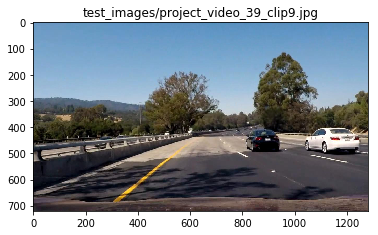

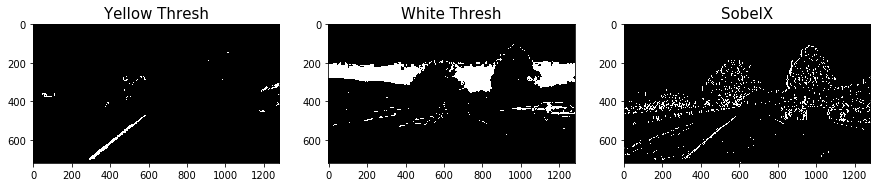

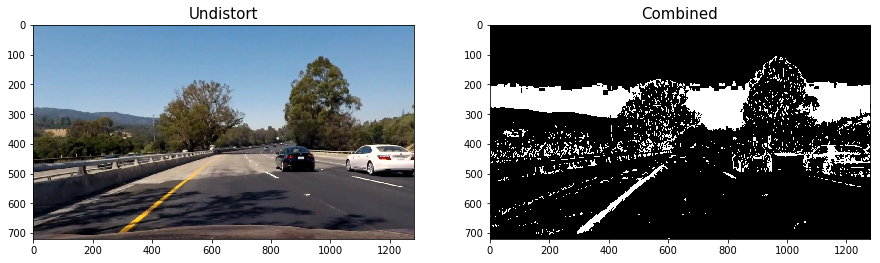

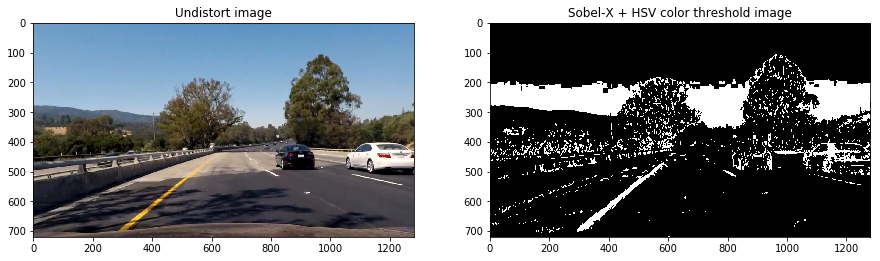

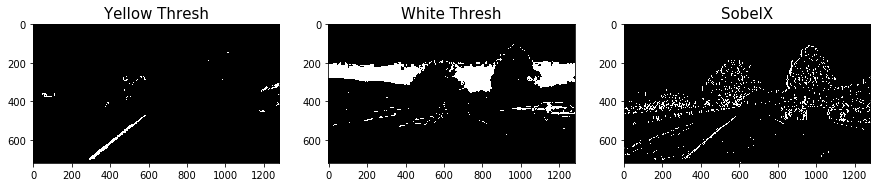

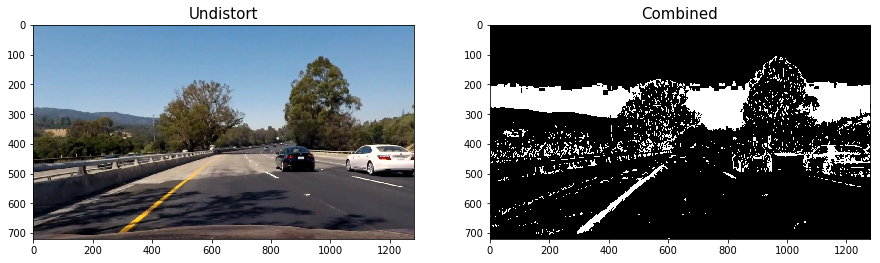

In [6]:

def HSV_pipeline(udist_img):
    yellow_low = np.array([0,100,100])
    yellow_high = np.array([50,255,255])
    white_low = np.array([18,0,180])
    white_high = np.array([255,80,255])
    imgThres_yellow, org_img = hsv_color_thresh(udist_img,yellow_low,yellow_high)
    imgThres_white, org_img = hsv_color_thresh(udist_img,white_low,white_high)
    imgThr_sobelx = sobel_x(udist_img,9,80,220) #Sobel x

    s_color_img = np.zeros_like(imgThres_yellow)
    s_color_img[(imgThres_yellow==1) | (imgThres_white==1) | (imgThr_sobelx==1)] =1

    if (debug_show == True): 
        print ('udist_img.shape=', udist_img.shape)
        plt.figure(figsize = (15,8))
        plt.subplot(1,3,1).set_title('Yellow Thresh', fontsize=FONTSIZE)
        plt.imshow(imgThres_yellow, cmap='gray')
        plt.subplot(1,3,2).set_title('White Thresh', fontsize=FONTSIZE)
        plt.imshow(imgThres_white, cmap='gray')
        plt.subplot(1,3,3).set_title('SobelX', fontsize=FONTSIZE)
        plt.imshow(imgThr_sobelx, cmap='gray')
        
        plt.figure(figsize = (15,8))
        plt.subplot(1,2,1).set_title('Undistort', fontsize=FONTSIZE)
        plt.imshow(udist_img, cmap='gray')
        plt.subplot(1,2,2).set_title('Combined', fontsize=FONTSIZE)
        plt.imshow(s_color_img, cmap='gray')
        
    return s_color_img



############### test color mask #####################


#fname = 'test_images/whiteCarLaneSwitch.jpg'  # Small image: 960 x 540

#Big image: 1280 x 720
#fname = 'test_images/straight_lines1.jpg' # Left yellow, Right white lane lines
#fname = 'test_images/straight_lines2.jpg' # Both white lane lines
#fname = 'test_images/test1.jpg'
#fname = 'test_images/test6.jpg'
#fname = 'test_images/project_video_39_clip8.jpg'
fname = 'test_images/project_video_39_clip9.jpg'
#fname = 'test_images/project_video_39_clip11.jpg'
#fname = 'test_images/test5.jpg'
image_orig = mpimg.imread(fname)
print ('image_orig.shape=', image_orig.shape)
plt.figure()
plt.imshow(image_orig)
plt.title(fname)

image_udist = do_undistort(image_orig)
image_scolor_mask = HSV_pipeline(image_udist)



plt.figure(figsize=(15,8))
#plt.subplot(1,3,1)
#plt.title('Original Image')
#plt.imshow(orig_image)

plt.subplot(1,2,1)
plt.title('Undistort image')
plt.imshow(image_udist, cmap='gray')
plt.subplot(1,2,2)
plt.title('Sobel-X + HSV color threshold image')
plt.imshow(image_scolor_mask, cmap='gray')

image_scolor_mask = HSV_pipeline(image_udist)


## Calculate the perspective and inverse perspective Matrix.
## And convert the image to Bird's eye image

## Note: In previous version, the code will has some problem with shadow and  curved lane. So except for LUV+Lab threshold, I also modify the trapezium to match better with the curved lane lines.

"""
##### It's ok for straight lane lines #####
ht_window = np.uint(img_size[1]/1.5)
hb_window = np.uint(img_size[1])
c_window = np.uint(img_size[0]/2)

ctl_window = c_window - .25*np.uint(img_size[0]/2)
ctr_window = c_window + .25*np.uint(img_size[0]/2)
cbl_window = c_window - 1*np.uint(img_size[0]/2)
cbr_window = c_window + 1*np.uint(img_size[0]/2) 

src = np.float32([[cbl_window, hb_window], [cbr_window, hb_window], [ctr_window, ht_window], [ctl_window,ht_window]]) # ok for hood
dst = np.float32([[0+100,img_size[1]],[img_size[0]-100,img_size[1]],[img_size[0],10], [10,10]])

######### It's for curved lane lines #########
ht_window = np.uint(img_size[1]/1.6) # 720/1.6=450
hb_window = np.uint(img_size[1])
c_window = np.uint(img_size[0]/2)    # 1280/2 = 640

ctl_window = c_window - .12*np.uint(img_size[0]/2)  # Adjust the trapezium to match the curved lane more.
ctr_window = c_window + .14*np.uint(img_size[0]/2)
cbl_window = c_window - 1*np.uint(img_size[0]/2)
cbr_window = c_window + 1*np.uint(img_size[0]/2)

src = np.float32([[cbl_window, hb_window], [cbr_window, hb_window], [ctr_window, ht_window], [ctl_window,ht_window]]) # ok for hood
dst = np.float32([[0+50,img_size[1]],[img_size[0]-100,img_size[1]],[img_size[0],10], [10,10]])
"""

"""
    if (True):
        # it's also OK， but it will only map one dash lane. so we always lost the lane information to do polynomial.
        ht_window = np.uint(img_size[1]/1.6) # 423
        hb_window = np.uint(img_size[1]) - 40
        c_window = np.uint(img_size[0]/2)

        ctl_window = c_window - .12*np.uint(img_size[0]/2)
        ctr_window = c_window + .15*np.uint(img_size[0]/2)
        #cbl_window = c_window - 1*np.uint(img_size[0]/2)
        #cbr_window = c_window + 1*np.uint(img_size[0]/2) 
        cbl_window = c_window - 420
        cbr_window = c_window + 460
        src = np.float32([[585, 450], [203, 720], [1127, 720], [695, 450]])
        dst = np.float32([[320, 0], [320, 720], [960,720], [960, 0]])
    else : 
        ht_window = np.uint(img_size[1]/1.6) # 720/1.6=450
        hb_window = np.uint(img_size[1])
        c_window = np.uint(img_size[0]/2)    # 1280/2 = 640

        ctl_window = c_window - .12*np.uint(img_size[0]/2)  # Adjust the trapezium to match the curved lane more.
        ctr_window = c_window + .15*np.uint(img_size[0]/2)
        cbl_window = c_window - 1*np.uint(img_size[0]/2)
        cbr_window = c_window + 1*np.uint(img_size[0]/2) 
    
"""


image_orig.shape= (720, 1280, 3)
gmtx= [[  1.15777942e+03   0.00000000e+00   6.67111050e+02]
 [  0.00000000e+00   1.15282305e+03   3.86129068e+02]
 [  0.00000000e+00   0.00000000e+00   1.00000000e+00]]
gdist= [[-0.24688833 -0.02372817 -0.00109843  0.00035105 -0.00259134]]
src=
 [[    0.           720.        ]
 [ 1280.           720.        ]
 [  729.59997559   450.        ]
 [  563.20001221   450.        ]]
dst=
 [[   50.   720.]
 [ 1180.   720.]
 [ 1280.    10.]
 [   10.    10.]]
Perspective M=
 [[ -6.49979798e-01  -1.48900007e+00   1.03526703e+03]
 [ -8.88178420e-16  -1.96020663e+00   8.81241357e+02]
 [ -1.24264200e-18  -2.41147264e-03   1.00000000e+00]]
Perspective Minv=
 [[  1.29411723e-01  -7.90771717e-01   5.62885050e+02]
 [ -3.40005801e-17  -5.10150300e-01   4.49565542e+02]
 [ -0.00000000e+00  -1.23021349e-03   1.00000000e+00]]
luv_img.shape= (720, 1280, 3)
lab_img.shape= (720, 1280, 3)
image_scolor_mask.shape= (720, 1280)
src=
 [[    0.           720.        ]
 [ 1280.        

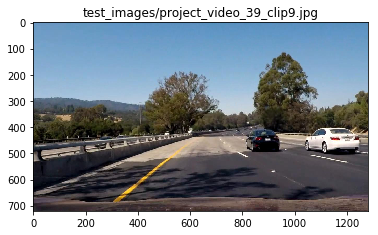

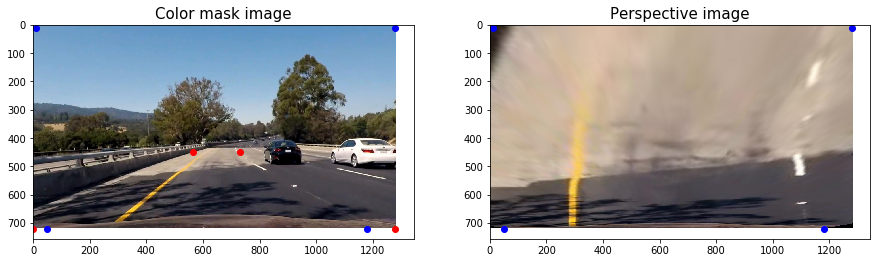

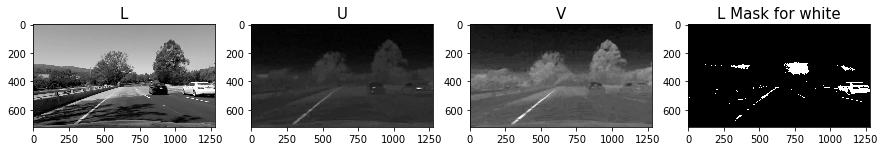

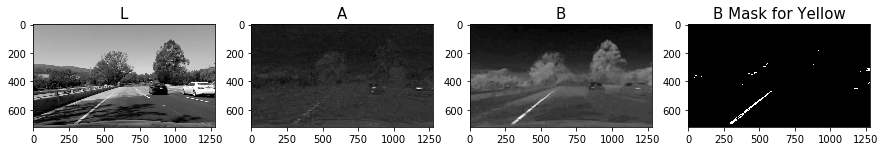

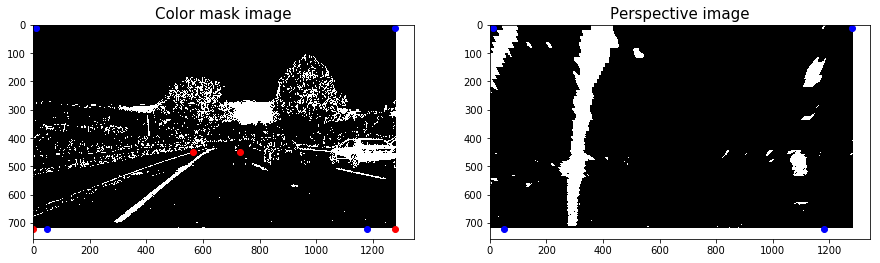

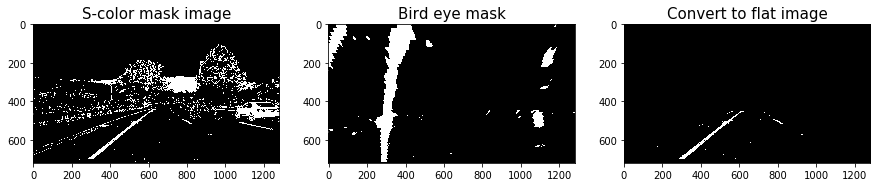

In [7]:

# MODIFY THIS FUNCTION TO GENERATE OUTPUT 
# THAT LOOKS LIKE THE IMAGE ABOVE
def calc_perspective_transform(img):
    #global src, dst
    global img_size
    # Pass in your image into this function
    # Write code to do the following steps    
    # d) use cv2.getPerspectiveTransform() to get M, the transform matrix  
    
    img_size = img.shape[1::-1]  

    # it's also OK， but it will only map one dash lane. so we always lost the lane information to do polynomial.
    ht_window = np.uint(img_size[1]/1.6) # 720/1.6=450
    hb_window = np.uint(img_size[1])
    c_window = np.uint(img_size[0]/2)    # 1280/2 = 640

    ctl_window = c_window - .12*np.uint(img_size[0]/2)  # Adjust the trapezium to match the curved lane more.
    ctr_window = c_window + .14*np.uint(img_size[0]/2)
    cbl_window = c_window - 1*np.uint(img_size[0]/2)
    cbr_window = c_window + 1*np.uint(img_size[0]/2)
        
    
    #print ('perspective window :', ctl_window, ctr_window, cbl_window, cbr_window)
    
    #[bottom_left, bottom_right, top_right, top_left]
    src = np.float32([[cbl_window, hb_window], [cbr_window, hb_window], [ctr_window, ht_window], [ctl_window,ht_window]]) # ok for hood
    dst = np.float32([[0+50,img_size[1]],[img_size[0]-100,img_size[1]],[img_size[0],10], [10,10]])
    
        
    M = cv2.getPerspectiveTransform(src, dst)
    Minv = cv2.getPerspectiveTransform(dst, src)
    if (debug_show == True):
        print ('src=\n', src)
        print ('dst=\n', dst)
        print ('Perspective M=\n', M)
        print ('Perspective Minv=\n',Minv)

    # e) use cv2.warpPerspective() to warp your image to a top-down view
    warped = cv2.warpPerspective(img, M, img_size, flags=cv2.INTER_LINEAR)
        
    ############ Draw Perspective Images #############
    if (debug_show == True):
        plt.figure(figsize = (15,10))
        plt.subplot(1,2,1).set_title('Color mask image', fontsize=15)
        plt.imshow(img, cmap='gray')
        plt.plot(src[:,0], src[:,1], 'ro')
        plt.plot(dst[:,0], dst[:,1], 'bo')
        plt.subplot(1,2,2).set_title('Perspective image', fontsize=15)
        plt.imshow(warped, cmap='gray')
        plt.plot(dst[:,0], dst[:,1], 'bo')
        
    return M, Minv #, orig_img


##########################  test   ##########################################

#fname = 'test_images/straight_lines1.jpg'
#fname = 'test_images/straight_lines2.jpg'
#fname = 'test_images/project_video_39_clip8.jpg'
fname = 'test_images/project_video_39_clip9.jpg'
#fname = 'test_images/project_video_39_clip11.jpg'
#fname = 'test_images/test5.jpg'
#fname = 'test_images/test6.jpg'

image_orig = mpimg.imread(fname)
print ('image_orig.shape=', image_orig.shape)
plt.figure()
plt.imshow(image_orig)
plt.title(fname)

debug_show = True
image_udist = do_undistort(image_orig)

persp_M, persp_Minv = calc_perspective_transform(image_udist)

debug_show = True
image_scolor_mask = L_pipeline(image_udist, w_thresh=(200, 255), y_thresh=(155, 200), sx_thresh=(20, 100))
#image_scolor_mask = HSV_pipeline(image_udist)
print ('image_scolor_mask.shape=', image_scolor_mask.shape)


debug_show = True
persp_M, persp_Minv = calc_perspective_transform(image_scolor_mask)

image_bird_mask = cv2.warpPerspective(image_scolor_mask, persp_M, img_size, flags=cv2.INTER_LINEAR)

image_convert2_orig = cv2.warpPerspective(image_bird_mask, persp_Minv, img_size, flags=cv2.INTER_LINEAR)

plt.figure(figsize = (15,10))
plt.subplot(1,3,1).set_title('S-color mask image', fontsize=15)
plt.imshow(image_scolor_mask, cmap='gray')
plt.subplot(1,3,2).set_title('Bird eye mask', fontsize=15)
plt.imshow(image_bird_mask, cmap='gray')
plt.subplot(1,3,3).set_title('Convert to flat image', fontsize=15)
plt.imshow(image_convert2_orig, cmap='gray')

print ('img_size=', img_size)

## Found the lane lines in Bird'eye image

In [8]:

ref_left =np.array([-0.0001,0,400])
ref_right=np.array([-0.0001,0,1000]) 

left_fit = []
right_fit= []

    
def find_1st_lane_pixels(binary_warped):  
    global left_fit, right_fit
    # Take a histogram of the bottom half of the image
    histogram = np.sum(binary_warped[binary_warped.shape[0]//2:,:], axis=0) #histogram.shape= (1280,)
    if (debug_show == True):
        plt.figure()
        plt.plot(histogram)
        plt.title('Lane Histogram ', fontsize=20)

    # Create an output image to draw on and visualize the result
    out_img = np.dstack((binary_warped, binary_warped, binary_warped))*255
        
    # Find the peak of the left and right halves of the histogram
    # These will be the starting point for the left and right lines
    midpoint = np.int(histogram.shape[0]//2)
    leftx_base = np.argmax(histogram[:midpoint])
    rightx_base = np.argmax(histogram[midpoint:]) + midpoint
    
    if (debug_show == True):
        print ('leftx_base=', leftx_base, ', rightx_base=', rightx_base, ', lane width=', abs(rightx_base - leftx_base))
        
    # HYPERPARAMETERS    
    nwindows = 9  # Choose the number of sliding windows    
    margin = 100  # Set the width of the windows +/- margin    
    minpix = 50   # Set minimum number of pixels found to recenter window

    # Set height of windows - based on nwindows above and image shape
    window_height = np.int(binary_warped.shape[0]//nwindows)
    #print ('window_height=', window_height, 'type(window_height)=',type(window_height))
    
    # Identify the x and y positions of all nonzero pixels in the image
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    
    # Current positions to be updated later for each window in nwindows
    leftx_current = leftx_base
    rightx_current = rightx_base

    # Create empty lists to receive left and right lane pixel indices
    left_lane_inds = []
    right_lane_inds = []

    # Step through the windows one by one
    for window in range(nwindows):
        # Identify window boundaries in x and y (and right and left)
        win_y_low = binary_warped.shape[0] - (window+1)*window_height
        win_y_high = binary_warped.shape[0] - window*window_height
        
        ### TO-DO: Find the four below boundaries of the window ###
        win_xleft_low = leftx_current - margin  # Update this
        win_xleft_high = leftx_current + margin  # Update this
        win_xright_low = rightx_current - margin  # Update this
        win_xright_high = rightx_current + margin  # Update this
        
        # Draw the windows on the visualization image
        cv2.rectangle(out_img, (win_xleft_low,win_y_low), (win_xleft_high,win_y_high), (0,255,0), 2)  #yellow
        cv2.rectangle(out_img, (win_xright_low,win_y_low), (win_xright_high,win_y_high), (0,255,0), 2)  #yellow 
        
        ### TO-DO: Identify the nonzero pixels in x and y within the window ###
        good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
                        (nonzerox >= win_xleft_low) &  (nonzerox < win_xleft_high)).nonzero()[0]
        good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
                        (nonzerox >= win_xright_low) &  (nonzerox < win_xright_high)).nonzero()[0]
                
        # Append these indices to the lists
        left_lane_inds.append(good_left_inds)
        right_lane_inds.append(good_right_inds)
                
        ### TO-DO: If you found > minpix pixels, recenter next window ###
        ### (`right` or `leftx_current`) on their mean position ###
        if len(good_left_inds) > minpix:
            leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
        if len(good_right_inds) > minpix:        
            rightx_current = np.int(np.mean(nonzerox[good_right_inds]))
    
    # Concatenate the arrays of indices (previously was a list of lists of pixels)
    try:
        left_lane_inds = np.concatenate(left_lane_inds)
        right_lane_inds = np.concatenate(right_lane_inds)
    except ValueError:
        # Avoids an error if the above is not implemented fully
        pass

    # Extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]
 
    ## Visualization ##
    # Colors in the left and right lane regions
    out_img[lefty, leftx] = [255, 0, 0]
    out_img[righty, rightx] = [0, 0, 255]
    
    # Fit a second order polynomial to each
    if len(leftx) == 0:
        left_fit =[]
    else:
        left_fit = np.polyfit(lefty, leftx, 2)
    
    if len(rightx) == 0:
        right_fit =[]
    else:
        right_fit = np.polyfit(righty, rightx, 2)
        
    if (debug_show == True):
        print ('find_1st_lane_pixels： left_fit=', left_fit, ', right_fit=', right_fit)        
        plt.figure(figsize = (8,6))
        plt.subplot(1,1,1).set_title('Rectangle Polynomial', fontsize=15)
        plt.imshow(out_img, cmap='gray')
        
    return leftx, lefty, rightx, righty, left_fit, right_fit, out_img


def find_later_lane_pixels(binary_warped, left_fit, right_fit):    
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    margin = 100
    left_lane_inds = ((nonzerox > (left_fit[0]*(nonzeroy**2) + left_fit[1]*nonzeroy + left_fit[2] - margin)) 
                            & (nonzerox < (left_fit[0]*(nonzeroy**2) + left_fit[1]*nonzeroy + left_fit[2] + margin))) 
    right_lane_inds = ((nonzerox > (right_fit[0]*(nonzeroy**2) + right_fit[1]*nonzeroy + right_fit[2] - margin)) 
                            & (nonzerox < (right_fit[0]*(nonzeroy**2) + right_fit[1]*nonzeroy + right_fit[2] + margin)))  

    # Again, extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]
    
    # Fit a second order polynomial to each
    if len(leftx) == 0:
        left_fit_updated =[]
    else:
        left_fit_updated = np.polyfit(lefty, leftx, 2)
    
    
    if len(rightx) == 0:
        right_fit_updated =[]
    else:
        right_fit_updated = np.polyfit(righty, rightx, 2)
        
    if (debug_show == True):
        print ('find_later_lane_pixels： left_fit_updated=', left_fit_updated, ', right_fit_updated=', right_fit_updated)
    
    return  leftx, lefty, rightx, righty, left_fit_updated, right_fit_updated


## Draw the founded lane area with color in a new image which will be added to the undistort image later.

In [9]:

def draw_lane_lines(undist_img, warp_birds_img, left_fit, right_fit, leftx, lefty, rightx, righty):   
    
    # Create an image to draw the lines on        
    warp_zero = np.zeros_like(warp_birds_img).astype(np.uint8)
    color_warp = np.dstack((warp_zero, warp_zero, warp_zero)) * 255
        
    # Find our lane pixels first
    #left_fit, right_fit, out_img = find_1st_lane_pixels(binary_warped)

    # Generate x and y values for plotting
    ploty = np.linspace(0, warp_birds_img.shape[0]-1, warp_birds_img.shape[0] )
    #print ('\nploty.shape=', ploty.shape, 'ndim=', ploty.ndim, 'type(ploty)=',type(ploty), 'ploty[:20]=', ploty[:20])
    #ploty.shape= (720,) ndim= 1 type(ploty)= <class 'numpy.ndarray'>
    #ploty[:20]= [ 0.  1.  2.  3.  4.  5.  6.  7.  8.  9. 10. 11. 12. 13. 14. 15. 16. 17. 18. 19.]
    try:
        left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
        right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    except TypeError:
        # Avoids an error if `left` and `right_fit` are still none or incorrect
        print('The function failed to fit a line!')
        left_fitx = 1*ploty**2 + 1*ploty
        right_fitx = 1*ploty**2 + 1*ploty

    #left_fitx.shape= (720,) ndim= 1 ,   right_fitx.shape= (720,) ndim= 1 
    
    ########## draw lane window ###############
    if (debug_show == True):
        print ('leftx.shape=', leftx.shape, ', rightx.shape=', rightx.shape )
        print ('top=0, bottom=', warp_birds_img.shape[0]-1)
        pnty = 0
        print ('left_fitx[top]=', left_fitx[pnty], ', right_fitx[top]=', right_fitx[pnty], ', lane width[top]=', abs(right_fitx[pnty] - left_fitx[pnty]))    
        pnty = warp_birds_img.shape[0]-1
        print ('left_fitx[bottom]=', left_fitx[pnty], ', right_fitx[bottom]=', right_fitx[pnty], ', lane width[bottom]=', abs(right_fitx[pnty] - left_fitx[pnty]))
    
    lane_pts_left = np.array([np.transpose(np.vstack([left_fitx, ploty]))])   #(1, 720, 2)
    lane_pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, ploty])))])  #(1, 720, 2)
    lane_pts = np.hstack((lane_pts_left, lane_pts_right))                    #(1, 1440, 2)
    
    cv2.fillPoly(color_warp, np.int_([lane_pts]), (100,165,40)) #(255,215, 0))   
    
    #draw left lane line points with red, right lane line points with blue.
    #if (debug_show == True):
    color_warp[lefty, leftx] = [255, 0, 0]
    color_warp[righty, rightx] = [0, 0, 255]
    
    new_color_warp = cv2.warpPerspective(color_warp, persp_Minv, color_warp.shape[1::-1], flags=cv2.INTER_LINEAR)    
        
    ####### draw image #########
    if (debug_show == True):
        plt.figure(figsize = (8,6))
        plt.subplot(1,1,1).set_title('Bird lane Left/Right lines', fontsize=15)
        plt.plot(left_fitx, ploty, color='yellow')
        plt.plot(right_fitx, ploty, color='yellow')
        plt.imshow(color_warp, cmap='gray')

    if (debug_show == True):
        plt.figure(figsize = (15,8))
        plt.subplot(1,2,1).set_title('Birds eye Lane image', fontsize=FONTSIZE)
        plt.imshow(color_warp, cmap='gray')    
        plt.subplot(1,2,2).set_title('Back to flat image', fontsize=FONTSIZE)
        plt.imshow(new_color_warp, cmap='gray')
    
    
    result = cv2.addWeighted(undist_img, 1, new_color_warp, 0.3, 0)
    
    #print ('out_img.shape=', out_img.shape, ', lane_window_img.shape=', lane_window_img.shape, ',result.shape=', result.shape)

    # Plots the left and right polynomials on the lane lines
    #plt.plot(left_fitx, ploty, color='yellow')
    #plt.plot(right_fitx, ploty, color='yellow')

    return result, color_warp



image_orig.shape= (720, 1280, 3)
leftx_base= 298 , rightx_base= 1083 , lane width= 785
find_1st_lane_pixels： left_fit= [  2.12509886e-04  -3.00227443e-01   3.96308504e+02] , right_fit= [  3.47063851e-04  -3.96013741e-01   1.19935022e+03]
leftx.shape= (48521,) , rightx.shape= (9877,)
top=0, bottom= 719
left_fitx[top]= 396.308503706 , right_fitx[top]= 1199.35022225 , lane width[top]= 803.041718546
left_fitx[bottom]= 290.304295485 , right_fitx[bottom]= 1094.03481769 , lane width[bottom]= 803.730522203
image_merge.shape= (720, 1280, 3)

left_fit= [  2.12509886e-04  -3.00227443e-01   3.96308504e+02]
right_fit= [  3.47063851e-04  -3.96013741e-01   1.19935022e+03]


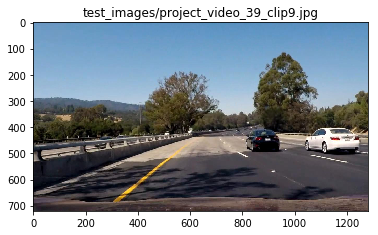

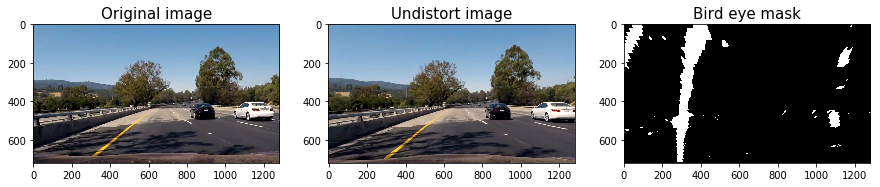

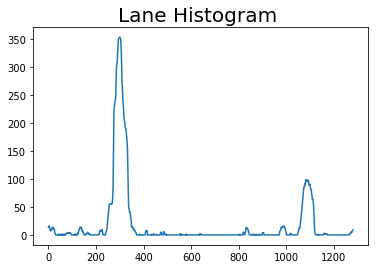

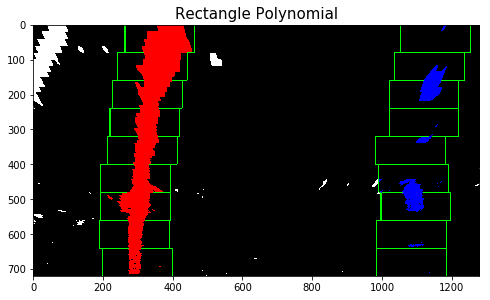

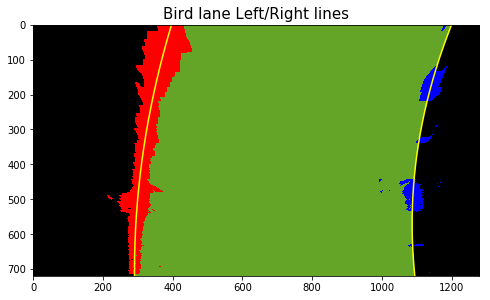

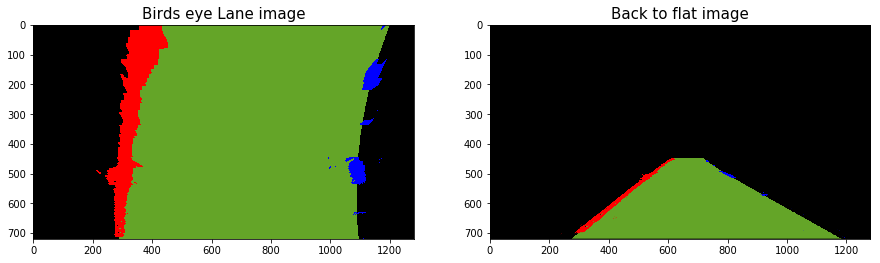

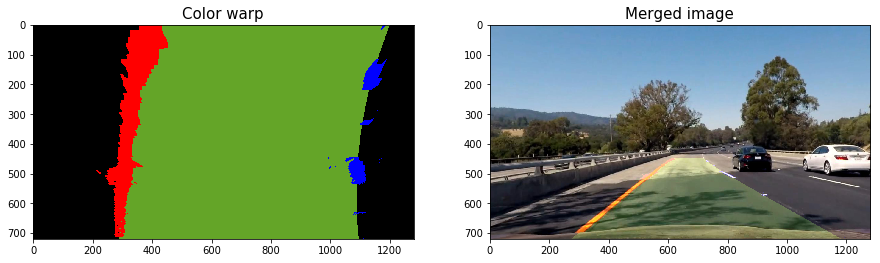

In [10]:
#############Test Image 1 #####################

#fname = 'test_images/whiteCarLaneSwitch.jpg'  # Small image: 960 x 540

#Big image: 1280 x 720
#fname = 'test_images/straight_lines1.jpg' # Left yellow, Right white lane lines
#fname = 'test_images/straight_lines2.jpg' # Both white lane lines
#fname = 'test_images/test1.jpg'
#fname = 'test_images/project_video_39_clip8.jpg'
fname = 'test_images/project_video_39_clip9.jpg'
#fname = 'test_images/project_video_39_clip11.jpg'
#fname = 'test_images/test5.jpg'

image_orig = mpimg.imread(fname)
print ('image_orig.shape=', image_orig.shape)
plt.figure()
plt.imshow(image_orig)
plt.title(fname)

debug_show = False
image_udist = do_undistort(image_orig)
image_scolor_mask = L_pipeline(image_udist, w_thresh=(200, 255), y_thresh=(155, 200), sx_thresh=(20, 100))
#image_scolor_mask = HSV_pipeline(image_udist)
image_bird_mask = cv2.warpPerspective(image_scolor_mask, persp_M, img_size, flags=cv2.INTER_LINEAR)

plt.figure(figsize = (15,8))
plt.subplot(1,3,1).set_title('Original image', fontsize=15)
plt.imshow(image_orig, cmap='gray')
plt.subplot(1,3,2).set_title('Undistort image', fontsize=15)
plt.imshow(image_udist, cmap='gray')
plt.subplot(1,3,3).set_title('Bird eye mask', fontsize=15)
plt.imshow(image_bird_mask, cmap='gray')



debug_show = True
leftx, lefty, rightx, righty, left_fit, right_fit, image_bird_lane = find_1st_lane_pixels(image_bird_mask)


image_merge, image_color_warp = draw_lane_lines(image_udist, image_bird_mask, left_fit, right_fit, leftx, lefty, rightx, righty)
        
print ('image_merge.shape=', image_merge.shape)

plt.figure(figsize = (15,8))
plt.subplot(1,2,1).set_title('Color warp', fontsize=15)
plt.imshow(image_color_warp, cmap='gray')
plt.subplot(1,2,2).set_title('Merged image', fontsize=15)
plt.imshow(image_merge, cmap='gray')

print ('\nleft_fit=', left_fit )
print ('right_fit=', right_fit )

In [11]:

def measure_curvature_real(binary_warped, leftx, lefty, rightx, righty):
    '''
    Calculates the curvature of polynomial functions in meters.
    '''
    #print ('binary_warped.shape=', binary_warped.shape)
    #print ('left_fit_cr=', left_fit_cr, ', right_fit_cr.shape=', right_fit_cr)
    # Define conversions in x and y from pixels space to meters
    ym_per_pix = 30/720 # meters per pixel in y dimension
    xm_per_pix = 3.7/700 # meters per pixel in x dimension
    
    # Start by generating our fake example data
    # Make sure to feed in your real data instead in your project!
    #ploty, left_fit_cr, right_fit_cr = generate_data(ym_per_pix, xm_per_pix)
    #ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
    
    left_fit_cr = np.polyfit(lefty*ym_per_pix, leftx*xm_per_pix, 2)
    right_fit_cr = np.polyfit(righty*ym_per_pix, rightx*xm_per_pix, 2)
    
    # Define y-value where we want radius of curvature
    # We'll choose the maximum y-value, corresponding to the bottom of the image
    
    # Calculation of R_curve (radius of curvature)
    y_eval = np.max(np.hstack([lefty, righty]))      
    left_curverad = ((1 + (2*left_fit_cr[0]*y_eval*ym_per_pix + left_fit_cr[1])**2)**1.5) / np.absolute(2*left_fit_cr[0])    
    right_curverad = ((1 + (2*right_fit_cr[0]*y_eval*ym_per_pix + right_fit_cr[1])**2)**1.5) / np.absolute(2*right_fit_cr[0])
    
    center = (((left_fit_cr[0]*720**2+left_fit_cr[1]*720+left_fit_cr[2]) 
                +(right_fit_cr[0]*720**2+right_fit_cr[1]*720+right_fit_cr[2]) ) /2 - 640)*xm_per_pix
    
    if (debug_show == True):
        print ('np.max(lefty)=', np.max(lefty))
        print ('np.max(righty)=', np.max(righty))
        print ('y_eval=', y_eval)
        print ('measure_curvature_real_pix: left_curverad=', left_curverad, ', right_curverad=', right_curverad, ', center=', center )
    
    return left_curverad, right_curverad, center

def sanity_check(left_fit, right_fit, minSlope, maxSlope):
    '''
    '''    
    xm_per_pix = 3.7/700 # meters per pixel in x dimension
    if len(left_fit) ==0 or len(right_fit) == 0:
        status = False
        d0=0
        d1=0
        #Previous fitlines routine returns empty list to them if not finds
    else:
        #Difference of slope
        L_0 = 2*left_fit[0]*460+left_fit[1]
        R_0 = 2*right_fit[0]*460+right_fit[1]
        d0 =  np.abs(L_0-R_0)

        L_1 = 2*left_fit[0]*720+left_fit[1]
        R_1 = 2*right_fit[0]*720+right_fit[1]
        d1 =  np.abs(L_1-R_1)
        
        if d0>= minSlope and d0<= maxSlope and d1>= minSlope and d1<= maxSlope:
            status = True
        else:
            status = False
            
    return(status, d0, d1)


debug_show = True
left_curv, right_curv, center_off = measure_curvature_real(image_bird_lane, leftx, lefty, rightx, righty)
print ('left_curv=', left_curv, ', right_curv=', right_curv, ', center_off=', center_off )

np.max(lefty)= 714
np.max(righty)= 718
y_eval= 718
measure_curvature_real_pix: left_curverad= 772.796158494 , right_curverad= 473.308506007 , center= -1.19451855744
left_curv= 772.796158494 , right_curv= 473.308506007 , center_off= -1.19451855744


## It's the callback function which will handle each frame.

In [12]:

global frame_cnt
frame_cnt = 0

def process_image(src_img):    
    global ref_left 
    global ref_right
    global left_fit
    global right_fit    
    global frame_cnt
    
    # undistort the image 
    #print ('\nFile-', fname, ', original: src_img.shape=', src_img.shape)
    udist_img = do_undistort(src_img)
    
    if (debug_show == True):
        plt.figure(figsize = (15,8))
        plt.subplot(1,2,1).set_title('Original ' + fname, fontsize=FONTSIZE)
        plt.imshow(src_img, cmap='gray')
        plt.subplot(1,2,2).set_title('Udistort image', fontsize=FONTSIZE)
        plt.imshow(udist_img, cmap='gray')
  
    ksize = 3 # Choose a larger odd number to smooth gradient measurements

    # Apply each of the thresholding functions    
    if (True) :
        # HLS color Thresh + Sobel X
        #s_color_img = S_pipeline(udist_img, s_thresh=(170, 255), sx_thresh=(20, 100))
        s_color_img = L_pipeline(udist_img, w_thresh=(200, 255), y_thresh=(155, 200), sx_thresh=(20, 100))        
    else:
        # HSV color thresh + Sobel X
        s_color_img = HSV_pipeline(udist_img)        
    #print ('s_color_img.shape=', s_color_img.shape)
    

    # Get Bird's Eye 
    img_size = s_color_img.shape[1::-1]
    warp_birds_img = cv2.warpPerspective(s_color_img, persp_M, img_size, flags=cv2.INTER_LINEAR)
    
    if (debug_show == True):
        # draw Bird eye image 
        print ('warp_birds_img.shape=', warp_birds_img.shape)
        plt.figure(figsize = (15,8))
        plt.subplot(1,2,1).set_title('Color Mask image', fontsize=FONTSIZE)
        plt.imshow(s_color_img, cmap='gray')    
        plt.subplot(1,2,2).set_title('Birds eye Mask', fontsize=FONTSIZE)
        plt.imshow(warp_birds_img, cmap='gray')
        
    if frame_cnt == 0:
        #left_fit, right_fit,out_imgfit = find_1st_lane_pixels(warp_birds_img)
        leftx, lefty, rightx, righty,  left_fit, right_fit, out_imgfit = find_1st_lane_pixels(warp_birds_img)        
    else:
        leftx, lefty, rightx, righty,  left_fit, right_fit = find_later_lane_pixels(warp_birds_img, left_fit, right_fit)
    
    status_sanity, d0, d1 =sanity_check(left_fit, right_fit, 0, .55)    
    if status_sanity  == True:        
        #Save as last reliable fit
        ref_left, ref_right = left_fit, right_fit        
        frame_cnt += 1
    else:       
        #Use the last realible fit
        left_fit, right_fit = ref_left, ref_right
    
    left_curv, right_curv, center_off = measure_curvature_real(warp_birds_img, leftx, lefty, rightx, righty)
        
    # Draw the lane lines      
    merge_img, color_warp_img = draw_lane_lines(udist_img, warp_birds_img, left_fit, right_fit, leftx, lefty, rightx, righty)
        
    #Composition of images to final display
    final_img=np.zeros((576,1280,3), dtype=np.uint8)    
    final_img[0:576,0:1024,:] =cv2.resize(merge_img,(1024,576))
    
    #b) Color Mask Image
    final_img[0:288,1024:1280, 0] =cv2.resize(s_color_img*255,(256,288))
    final_img[0:288,1024:1280, 1] =cv2.resize(s_color_img*255,(256,288))
    final_img[0:288,1024:1280, 2] =cv2.resize(s_color_img*255,(256,288))
    #c)Birds eye view
    final_img[310:576,1024:1280,:] =cv2.resize(color_warp_img,(256,266))
        
    #Write curvature and center in image
    TextL = "Left curv: " + str(int(left_curv)) + " m"
    TextR = "Right curv: " + str(int(right_curv))+ " m"
    TextC = "Center offset: " + str(round( center_off,2)) + "m"
    #TextAux = str(status_sanity) + ", d0: " + str(round(d0,2)) + ", d1: " + str(round(d1,2))
    fontScale=1
    thickness=2    
    fontFace = cv2.FONT_HERSHEY_SIMPLEX

    cv2.putText(final_img, TextL, (130,40), fontFace, fontScale,(255,255,255), thickness,  lineType = cv2.LINE_AA)
    cv2.putText(final_img, TextR, (130,70), fontFace, fontScale,(255,255,255), thickness,  lineType = cv2.LINE_AA)
    cv2.putText(final_img, TextC, (130,100), fontFace, fontScale,(255,255,255), thickness,  lineType = cv2.LINE_AA)
    #cv2.putText(final_img, TextAux, (100,130), fontFace, fontScale,(255,255,255), thickness,  lineType = cv2.LINE_AA)

    cv2.putText(final_img, "Thresh. view", (1070,30), fontFace, .8,(200,200,0), thickness,  lineType = cv2.LINE_AA)
    cv2.putText(final_img, "Birds-eye", (1080,305), fontFace, .8,(200,200,0), thickness,  lineType = cv2.LINE_AA)
        
    if (debug_show == True):
        plt.figure(figsize=(30,20))
        #plt.subplot(1,2,1).set_title('Undistort image', fontsize=FONTSIZE)
        #plt.imshow(udist_img, cmap='gray')    
        plt.subplot(1,1,1).set_title('Final image', fontsize=30)
        plt.imshow(final_img, cmap='gray')

    return final_img

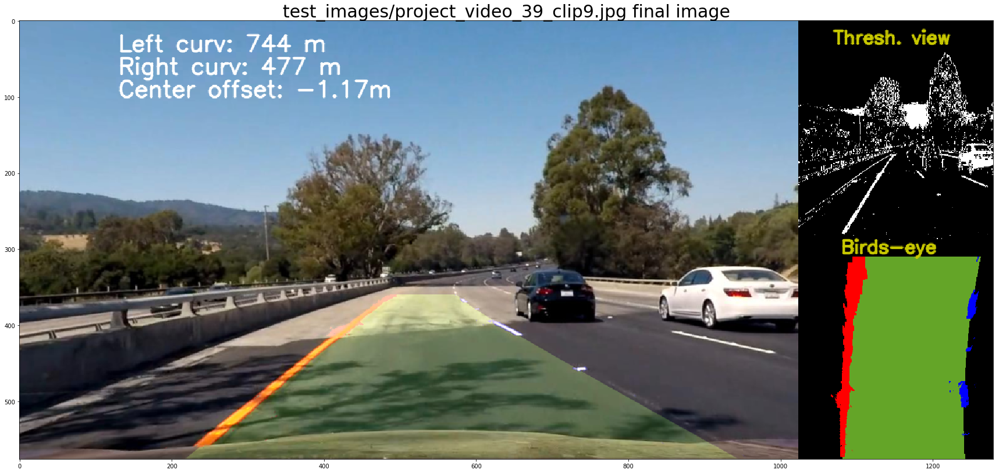

In [13]:

##################### test ####################
# Small images: 960 x 540
#fname = 'test_images/whiteCarLaneSwitch.jpg'

# Big images: 1280 x 720
#fname = 'test_images/straight_lines1.jpg'
#fname = 'test_images/straight_lines2.jpg'
#fname = 'test_images/test1.jpg' 
#fname = 'test_images/test5.jpg'
#fname = 'test_images/project_video_39_clip4.jpg'
#fname = 'test_images/project_video_39_clip8.jpg'
fname = 'test_images/project_video_39_clip9.jpg'
#fname = 'test_images/project_video_39_clip12.jpg'

debug_show = False

frame_cnt = 0

if (True):    
    #image = mpimg.imread(fname)
    imgcv2 = cv2.imread(fname)
    image = cv2.cvtColor(imgcv2, cv2.COLOR_BGR2RGB)

    result = process_image(image)

    plt.figure(figsize=(30,20))   
    plt.subplot(1,1,1).set_title(fname+' final image', fontsize=30)
    plt.imshow(result, cmap='gray')
    

if (False):
    #1st Frame
    fname = 'test_images/project_video_39_clip7.jpg'
    image = mpimg.imread(fname)
    result = process_image(image)

    plt.figure(figsize=(30,20))   
    plt.subplot(1,1,1).set_title(fname+' final image', fontsize=30)
    plt.imshow(result, cmap='gray')
    
    #2nd Frame
    fname = 'test_images/project_video_39_clip8.jpg'
    image = mpimg.imread(fname, fname)
    result = process_image(image)

    plt.figure(figsize=(30,20))   
    plt.subplot(1,1,1).set_title(fname+' final image', fontsize=30)
    plt.imshow(result, cmap='gray')


type(files)= <class 'list'> len(files)= 10

File- 1  = test_images/project_video_39_clip1.jpg , original: image.shape= (720, 1280, 3)

File- 2  = test_images/project_video_39_clip2.jpg , original: image.shape= (720, 1280, 3)

File- 3  = test_images/project_video_39_clip3.jpg , original: image.shape= (720, 1280, 3)

File- 4  = test_images/project_video_39_clip4.jpg , original: image.shape= (720, 1280, 3)

File- 5  = test_images/project_video_39_clip5.jpg , original: image.shape= (720, 1280, 3)

File- 6  = test_images/project_video_39_clip6.jpg , original: image.shape= (720, 1280, 3)

File- 7  = test_images/project_video_39_clip7.jpg , original: image.shape= (720, 1280, 3)

File- 8  = test_images/project_video_39_clip8.jpg , original: image.shape= (720, 1280, 3)

File- 9  = test_images/project_video_39_clip9.jpg , original: image.shape= (720, 1280, 3)

File- 10  = test_images/project_video_39_clip10.jpg , original: image.shape= (720, 1280, 3)

File- 11  = test_images/project_video_39_cli

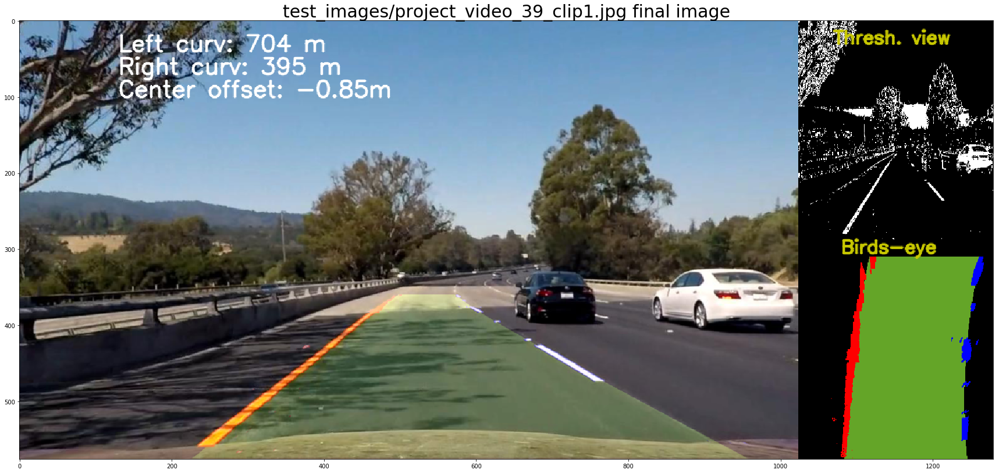

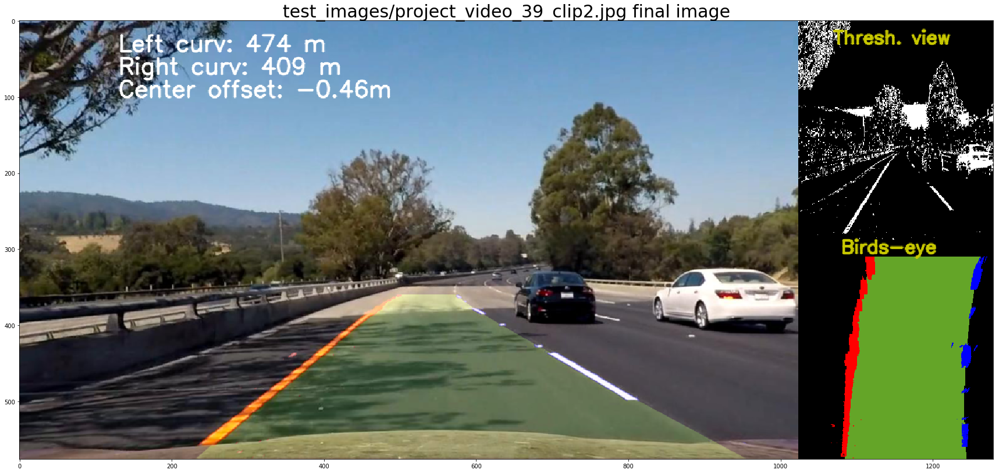

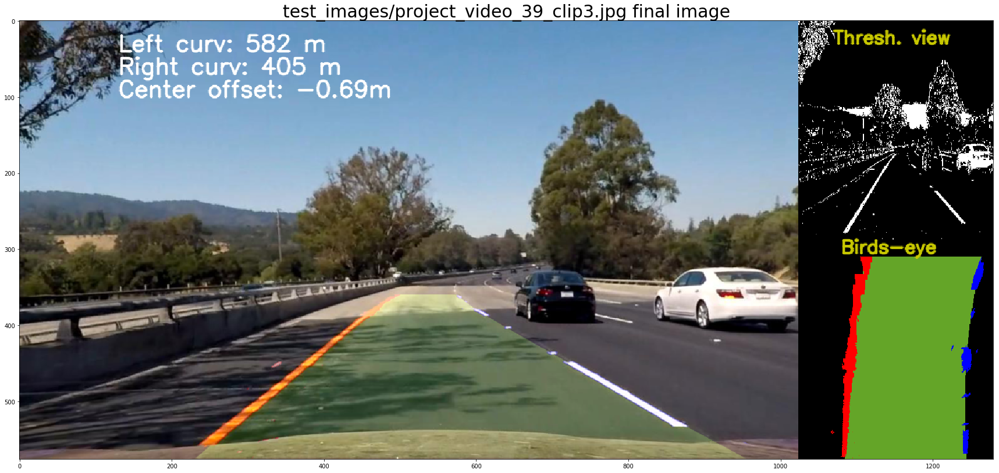

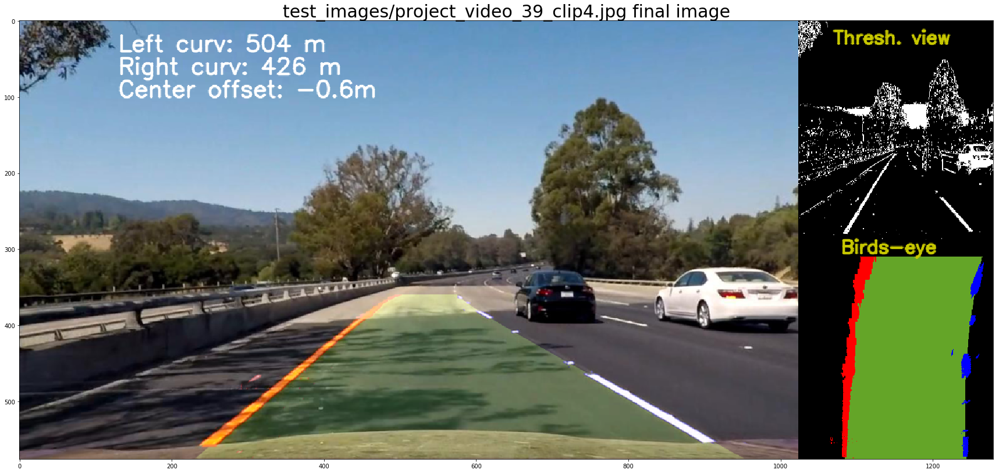

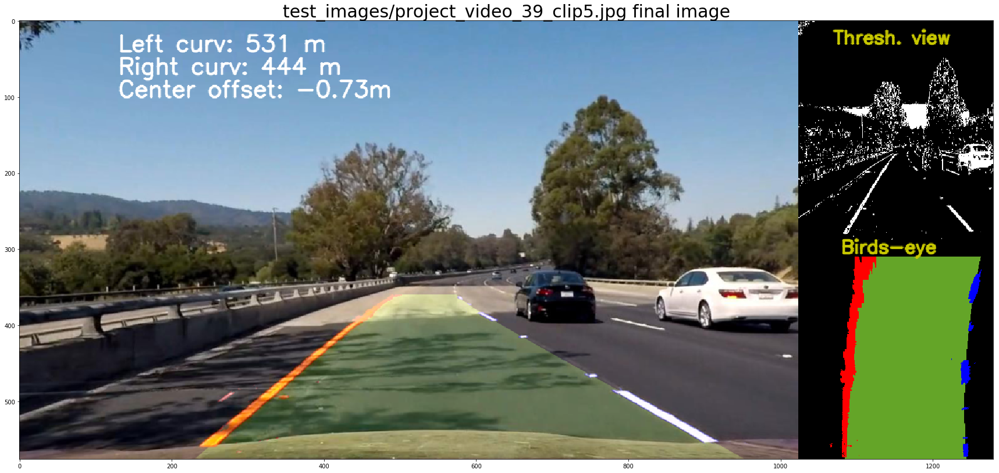

...

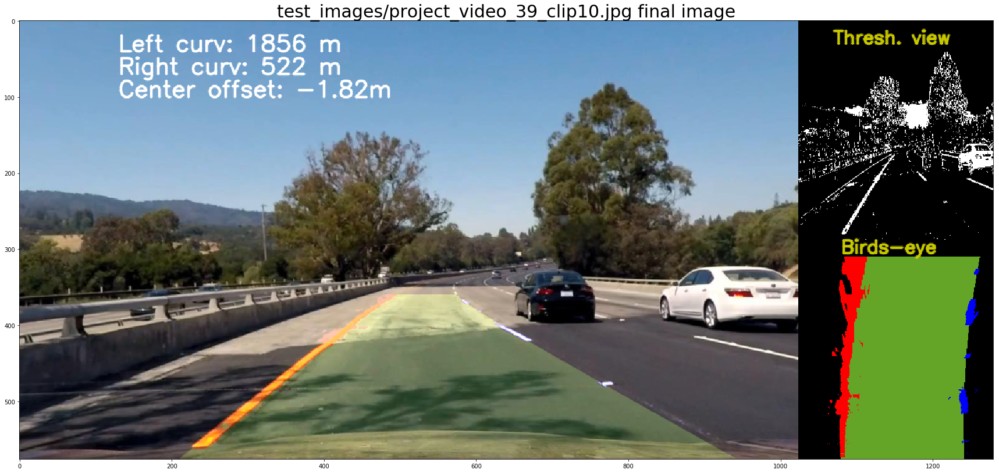

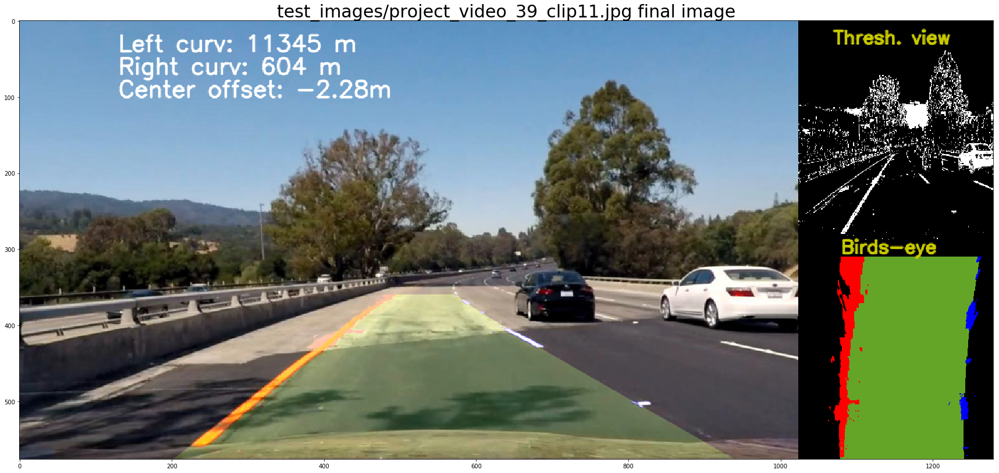

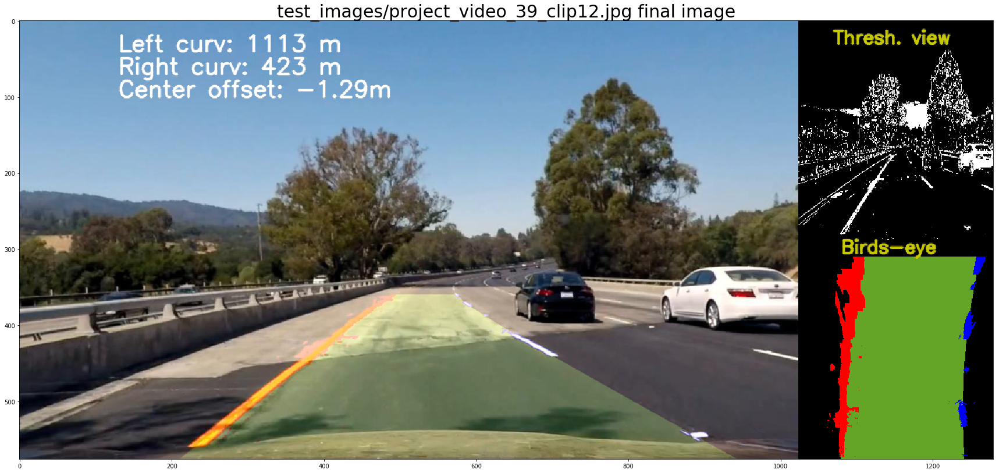

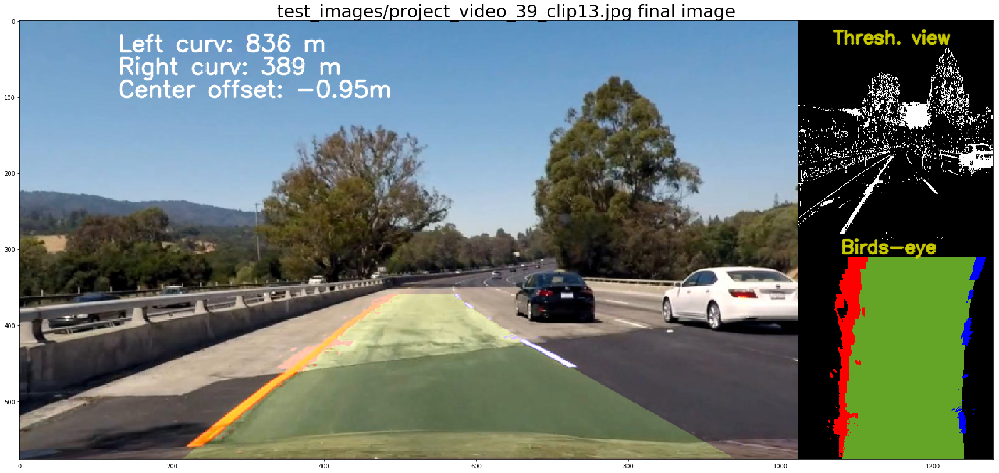

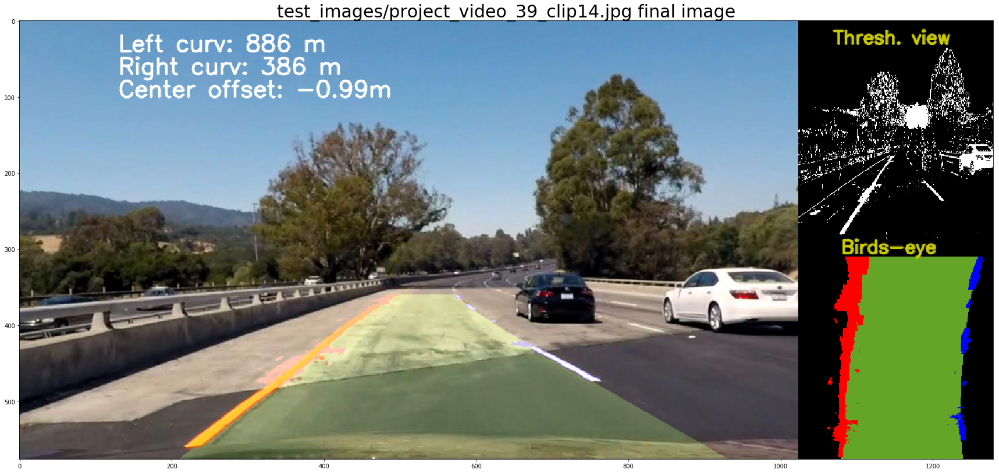

In [14]:

debug_show = False

files = glob.glob('test_images/project_video_39_clip?.jpg')
#files = glob.glob('camera_cal/calibration*.jpg')
print ('type(files)=', type(files), 'len(files)=', len(files))
#print ('files=', files)

frame_cnt = 0

# Step through the list and search for chessboard corners
#for fname in images:
#for idx, fname in enumerate(files):    
for idx in range(1, 15):
    fname = 'test_images/project_video_39_clip' + str(idx) + '.jpg'
    image = mpimg.imread(fname)
    print ('\nFile-',idx,' =', fname, ', original: image.shape=', image.shape)

    result = process_image(image)

    plt.figure(figsize=(30,20))   
    plt.subplot(1,1,1).set_title(fname+' final image', fontsize=30)
    plt.imshow(result, cmap='gray')
    

## Process the video file with the process_image() function

In [15]:
# Import everything needed to edit/save/watch video clips
from moviepy.editor import VideoFileClip
from IPython.display import HTML
import moviepy as mve


In [16]:
debug_show = False

#Create video file pipeline
frame_cnt=0
output = 'project_video_output_clip_luvlab_38_40.mp4'
#clip1 = VideoFileClip("project_video.mp4")
clip1 = VideoFileClip("project_video.mp4").subclip(38,40)
#clip1 = VideoFileClip("challenge_video.mp4")
#clip1 = VideoFileClip("challenge_video.mp4")

#clip1.save_frame("frame.jpeg")
#clip1 = clip1.fx(mve.vfx.rotate, lambda t: 90*t, expand=False)
out_clip = clip1.fl_image(process_image) #NOTE: this function expects color images!!
%time out_clip.write_videofile(output, audio=False)
print('Total frame =', frame_cnt)

[MoviePy] >>>> Building video project_video_output_clip_luvlab_38_40.mp4
[MoviePy] Writing video project_video_output_clip_luvlab_38_40.mp4


 98%|█████████▊| 50/51 [00:03<00:00, 16.51it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: project_video_output_clip_luvlab_38_40.mp4 

CPU times: user 11 s, sys: 2.81 s, total: 13.8 s
Wall time: 3.45 s
Total frame = 51


In [17]:
video_output = 'project_video_output_clip_luvlab_38_40.mp4'

HTML("""
<video width="960" height="540" controls>
  <source src="{0}">
</video>
""".format(video_output))

In [ ]:
debug_show = False

#Create video file pipeline
frame_cnt=0
output = 'project_video_output_all_luvlab.mp4'
clip1 = VideoFileClip("project_video.mp4")
#clip1 = VideoFileClip("project_video.mp4").subclip(38,40)
#clip1 = VideoFileClip("challenge_video.mp4")
#clip1 = VideoFileClip("challenge_video.mp4")

#clip1.save_frame("frame.jpeg")
#clip1 = clip1.fx(mve.vfx.rotate, lambda t: 90*t, expand=False)
out_clip = clip1.fl_image(process_image) #NOTE: this function expects color images!!
%time out_clip.write_videofile(output, audio=False)
print('Total frame =', frame_cnt)

In [ ]:
video_output = 'project_video_output_all_luvlab.mp4'

HTML("""
<video width="960" height="540" controls>
  <source src="{0}">
</video>
""".format(video_output))